# CAPSTONE PART 3: EDA

This isn't anywhere near finished - I still need to clean up the charts, add a lot more commentary on the decisions I have made from the data and comment my code better - but I am submitting as is as I know I am very behind and you need to see where I have got to.

## Import Data

In [1]:
import pandas as pd
from sklearn.preprocessing import Imputer
from tqdm import tqdm
import seaborn as sns
sns.set_style("whitegrid")
pd.set_option('display.max_rows',None)

In [2]:
# import data
lang = pd.read_csv("/Users/lizspiking/GeneralAssembly/DSI5-lessons/projects/project-capstone/lang.csv")

In [3]:
lang.shape

(51861, 502)

In [4]:
lang.head()

,country_id,school_id,main_study_sample,respondent_id,targetLanguage_id,TL,questLanguage_id,TESTING_grade,test_mode,SQt01i01,SQt02i01C,SQt03i01,SQt04i00,SQt04i01,SQt04i02,SQt04i03,SQt04i04,SQt04i05,SQt04i06,SQt04i07,SQt04i08,SQt04i09,SQt04i10,SQt04i11,SQt04i12,SQt05i01,SQt05i01TC,SQt06i01,SQt09i01,SQt12i01,SQt13i01,SQt14i01,SQt15i01,SQt16i01,SQt17i01,SQt18i01,SQt19i01,SQt19i02,SQt19i03,SQt19i04,SQt19i05,SQt19i06,SQt19i07,SQt19i08,SQt20i01,SQt20i02,SQt20i03,SQt20i04,SQt20i05,SQt20i06,SQt20i07,SQt20i08,SQt21i01,SQt22i01,SQt22i02,SQt22i03,SQt22i04,SQt22i05,SQt23i01,SQt23i02,SQt23i03,SQt23i04,SQt23i05,SQt23i06,SQt23i07,SQt23i08,SQt23i09,SQt24i01,SQt24i02,SQt24i03,SQt24i04,SQt24i05,SQt24i06,SQt25i00,SQt25i01,SQt25i02,SQt25i03,SQt25i04,SQt25i05,SQt25i06,SQt25i07,SQt25i08,SQt25i09,SQt25i10,SQt25i11,SQt25i12,SQt26i00,SQt26i01,SQt26i02,SQt26i03,SQt26i04,SQt26i05,SQt26i06,SQt26i07,SQt26i08,SQt26i09,SQt26i10,SQt26i11,SQt26i12,SQt27i01,SQt28i01,SQt28i02,SQt29i01,SQt29i02,SQt29i03,SQt29i04,SQt29i05,SQt29i06,SQt29i07,SQt30i01,SQt30i02,SQt30i03,SQt30i04,SQt30i05,SQt30i06,SQt31i01,SQt31i02,SQt31i03,SQt31i04,SQt31i05,SQt31i06,SQt31i07,SQt31i08,SQt31i09,SQt32i01,SQt32i02,SQt32i03,SQt32i04,SQt33i01,SQt33i02,SQt33i03,SQt33i04,SQt33i05,SQt33i06,SQt33i07,SQt33i08,SQt33i09,SQt33i10,SQt34i01,SQt34i02,SQt34i03,SQt34i04,SQt34i05,SQt34i06,SQt34i07,SQt34i08,SQt34i09,SQt35i01,SQt35i02,SQt35i03,SQt35i04,SQt35i05,SQt35i06,SQt35i07,SQt35i08,SQt35i09,SQt36i01,SQt36i02,SQt36i03,SQt36i04,SQt36i05,SQt36i06,SQt36i07,SQt36i08,SQt36i09,SQt37i00,SQt37i01,SQt37i02,SQt37i03,SQt37i04,SQt37i05,SQt37i06,SQt37i07,SQt37i08,SQt37i09,SQt37i10,SQt38i01,SQt39i00,SQt39i01,SQt39i02,SQt39i03,SQt39i04,SQt39i05,SQt39i06,SQt39i07,SQt39i08,SQt39i09,SQt39i10,SQt39i11,SQt39i12,SQt39i13,SQt39i14,SQt40i00,SQt40i01,SQt40i02,SQt40i03,SQt40i04,SQt40i05,SQt40i06,SQt40i07,SQt40i08,SQt40i09,SQt40i10,SQt40i11,SQt40i12,SQt40i13,SQt40i14,SQt41i01,SQt42i01,SQt42i01C,SQt43i01,SQt43i01C,SQt44i01,SQt44i01C,SQt44i02,SQt44i02C,SQt44i03,SQt44i03C,SQt45i01,SQt45i02,SQt45i03,SQt45i04,SQt45i05,SQt45i06,SQt46i01,SQt46i02,SQt46i03,SQt46i04,SQt46i05,SQt46i06,SQt46i07,SQt47i01,SQt48i01,SQt48i02,SQt48i03,SQt48i04,SQt48i05,SQt48i06,SQt48i07,SQt49i01,SQt49i02,SQt50i01,SQt50i02,SQt50i03,SQt51i01,SQt51i02,SQt51i03,SQt51i04,SQt51i05,SQt51i06,SQt51i07,SQt51i08,SQt51i09,SQt52i01,SQt52i02,SQt52i03,SQt52i04,SQt52i05,SQt52i06,SQt52i07,SQt53i01,SQt53i02,SQt53i03,SQt53i04,SQt53i05,SQt53i06,SQt54i01,SQt54i02,SQt54i03,SQt54i04,SQt54i05,SQt54i06,SQt55i01,SQt55i02,SQt55i03,SQt55i04,SQt55i05,SQt55i06,SQt56i01,SQt56i02,SQt57i01,SQt57i02,SQt57i03,SQt57i04,SQt57i05,SQt57i06,SQt57i07,SQt58i01,SQt58i02,SQt58i03,SQt58i04,SQt58i05,SQt58i06,SQt58i07,SQt59i01,SQt59i02,SQt60i01,SQt61i01,SQt61i02,SQt61i03,SQt61i04,SQt61i05,SQt61i06,SQt61i07,SQt62i01,SQt62i02,SQt62i03,SQt62i04,SQt62i05,SQt62i06,SQt62i07,SQt62i08,SQt62i09,SQt63i01,SQt63i02,SQt64i01,SQt64i02,SQt64i03,SQt64i04,SQt64i05,SQt64i06,SQtA1i01,SQtA1i02,SQtA1i03,SQtA1i04,SQtA2i01,SQtA2i02,SQtA2i03,SQtA2i04,SQtA3i01,SQtA3i02,SQtA3i03,SQtA3i04,SQtA4i01,SQtA4i02,SQtA4i03,SQtA4i04,ISCO_M,ISCO_F,ISEI_M,ISEI_F,HISEI,MPARED,FPARED,PARED,HOMEPOS,I01_ST_M_S39A,I01_ST_M_S39B,I01_ST_M_S40A,I01_ST_M_S40B,I01_ST_M_S44A,I01_ST_M_S44B,I01_ST_M_S59A,I01_ST_M_S63A,I01_ST_M_S63B,I02_ST_M_S37A,I02_ST_M_S37B,I02_ST_M_S38A,I02_ST_M_S41A,I03_ST_A_S03A,I03_ST_A_S04A,I03_ST_A_S04B,I03_ST_A_S25A,I03_ST_A_S25B,I03_ST_A_S26A,I03_ST_A_S26B,I03_ST_A_S27B,I03_ST_A_S28A,I03_ST_A_S29A,I03_ST_A_S30A,I03_ST_A_S31A,I03_ST_A_S45A,I04_ST_M_S64A,I04_ST_M_S64B,I05_ST_A_S23A,I05_ST_A_S24A,I05_ST_M_S62A,I06_ST_M_S45A,I06_ST_M_S46A,I08_ST_A_S01A,I08_ST_A_S02A,I08_ST_A_S15A,I08_ST_A_S19B,I08_ST_M_S64A,I08_ST_M_S64B,I09_IN_M_S49A,I09_IN_M_S50A,I09_IN_M_S51A,I09_IN_M_S57A,I09_ST_M_S33B,I09_ST_M_S48A,I09_ST_M_S52B,I14_IN_A_S42A,I14_ST_A_S06A,I14_ST_A_S06B,I14_ST_A_S06C,I14_ST_M_S47A,PV1_LIST,PV2_LIST,PV3_LIST,PV4_LIST,PV5_LIST,PV1_READ,PV2_READ,PV3_READ,PV4_READ,PV5_READ,PV1_WRIT1,PV2_WRIT1,PV3_WRIT1,PV4_WRIT1,PV5_WRIT1,PV1_WRIT

## Drop Columns with High Proportion of Missing Values

In [5]:
# drop any columns with all missing values
lang.dropna(axis=1, how='all', inplace=True)

In [6]:
lang.shape

(51861, 500)

DECISION:
On the basis that more than 20% of the values in the following columns are missing, I will drop these columns as I don't believe I will get reliable data by imputing values:
- SQt04i01
- SQt04i02
- SQt04i03
- SQt04i04
- SQt25i01
- SQt25i02
- SQt25i03
- SQt25i04
- SQt26i01
- SQt26i02
- SQt26i03
- SQt26i04
- SQt37i07
- SQt37i08
- SQt37i09
- SQt39i00
- SQt39i01
- SQt39i02
- SQt39i03
- SQt39i04
- SQt40i00
- SQt40i01
- SQt40i02
- SQt40i03
- SQt40i04

In [7]:
# set list of columns to drop
drop_columns = ['SQt04i01','SQt04i02','SQt04i03','SQt04i04','SQt04i08',\
                'SQt04i10','SQt25i01','SQt25i02','SQt25i03','SQt25i04',\
                'SQt25i08','SQt25i10','SQt26i01','SQt26i02','SQt26i03',\
                'SQt26i04','SQt26i08','SQt26i10','SQt37i05','SQt37i06',\
                'SQt37i07','SQt37i08','SQt37i09','SQt39i00','SQt39i01',\
                'SQt39i03','SQt39i04','SQt40i00','SQt40i01','SQt40i03',\
                'SQt40i04']

In [8]:
# drop columns from df'SQt39i02' 'SQt40i02'
lang.drop(drop_columns, axis=1, inplace=True)

In [9]:
lang.shape

(51861, 469)

DECISION: On the basis that less than 20% of the values in the remaining columns are missing, I will leave these in place for the moment. For the columns that I keep, I will impute values with either the mean, mode or 0, depending on what makes sense for that feature.

## Drop Weighted Columns

There are some weightings already attributed to the results in the df but as I do not have the detail of how they have been calculated, I would prefer to drop these are calculate my own if necessary, otherwise I risk not being able to explain how they were reached.

In [10]:
# create list of replicate_weight columns
replicate_weight = [col for col in lang.columns if 'RPW' in col or 'FSW' in col]

In [11]:
# save replicate weight data in case I need it later
replicate_weights = lang[replicate_weight].copy()

In [12]:
# drop replicate_weight columns from main df
lang.drop(replicate_weight, axis=1, inplace=True)

## Drop Plausible Value Columns

Similarly to the weightings, plausible values have been calculated in the df but I do not have the detail of how they have been calculated so I will drop these columns as I risk having results that I can't explain if I keep them in. Also, as they have most likely been calculated from the plausible levels which I am using as my targets, I expect them to be strongly correlated and to skew my model results if I leave them in.

In [13]:
# separate plausible values and drop from main df
results_pv = [col for col in lang.columns if 'PV' in col]

In [14]:
# subset to continuous results
plausible = lang.loc[:, results_pv].copy()
lang.drop(results_pv, axis=1, inplace=True)

## Drop Additional Columns

There are a number of columns in the df which are tracking information which should not logically correlate with my targets so I will drop those here. The country_id is useful but having the full country name would make things clearer so I will translate this to the full country name before dropping the id column.

In [15]:
# create dictionary of country codes and names
country_codes = tuple(lang['country_id'].unique())
country_names = ('Portugal', 'Greece', 'Belgium (Flemish)',\
                 'Spain', 'Belgium (French)', 'Slovenia',\
                'Malta', 'Sweden', 'Poland', 'Croatia',\
                'Estonia', 'UK', 'Belgium (German)',\
                 'Bulgaria', 'Netherlands', 'France')

In [16]:
# combine into dictionary and map to new column in df
countries = {code:country for code,country in zip(country_codes,country_names)}
lang['country'] = lang['country_id'].map(countries)

In [17]:
# drop columns that will not logically contribute to any predictions or
# which have a clearer equivalent
for_deletion = ['country_id','main_study_sample','respondent_id',\
                'targetLanguage_id','version_stu','JKzone','JKrep']

lang.drop(for_deletion, axis=1, inplace=True)

## Set Data Types

Due to the categorical nature of my data, there are many features that aren't the most sppropriate data type for me to work with going forward. I will review the types and amend as appropriate.

In [18]:
# convert DOB field to datetime
lang['SQt02i01C'] = pd.to_datetime(lang['SQt02i01C'])

In [19]:
# separate out birth month and assign to seasons
lang['SQt02i01C_month'] = lang['SQt02i01C'].dt.month

lang['SQt02i01C_month'] = lang['SQt02i01C_month'].map(lambda x: 'Summer' if 6<=x<=8 
                                                                 else 'Autumn' if 9<=x<=11
                                                                 else 'Winter' if x==12
                                                                 else 'Winter' if 1<=x<=2
                                                                 else 'Spring')

In [20]:
# drop full DOB column
lang.drop('SQt02i01C', axis=1, inplace=True)

In [21]:
# clean empty strings in HISEI column and convert to float
lang.loc[lang['HISEI']=='  ','HISEI'] = np.nan

lang['HISEI'] = lang['HISEI'].map(lambda x: float(x))

In [22]:
# clarify language codes & names
lang_codes = tuple(lang['questLanguage_id'].unique())
lang_names = ('Portuguese','Greek','Norwegian','Spanish','French',\
              'Spanish','Slovenian','Unknown','Maltese','Swedish',\
              'Polish','Croatian','Estonian','English','Bengali',\
              'Bulgarian','Unknown','Dutch','French','Arabic','Arabic')

# create dictionary to use for mapping
lang_dict = {code:name for code,name in zip(lang_codes,lang_names)}

# map full language names to DF
lang['questLanguage_id'] = lang['questLanguage_id'].map(lang_dict)

In [23]:
# clarify test mode field
test_mode_dict = {'PB':'Paper', 'CB':'PC'}

# map full names to DF
lang['test_mode'] = lang['test_mode'].map(test_mode_dict)

In [24]:
lang.shape

(51861, 389)

## Evaluate Distribution of Categorical Results

In [25]:
# create lists of columns for each of the three test disciplines
cols = lang.columns
writing = [col for col in cols if 'WRIT' in col and 'PL' in col]
reading = [col for col in cols if 'READ' in col and 'PL' in col]
listening = [col for col in cols if 'LIST' in col and 'PL' in col]

In [26]:
# create list of columns the three test disciplines together
combined = [col for col in cols if 'PL' in col]

As the writing discipline has three times the features of the other two disciplines, if a student was not tested on writing then their most frequent result will be 'Not Tested' and so they won't get an overall level across multiple disciplines. To avoid this, I will populate the 'PL_ALL' column for those students with the mode from the other two disciplines, rather than across all 25 results columns.

In [27]:
# function to fill na values in specific columns with zeros
def fill_nan(columns):
    for col in columns:
        lang[col].fillna('Not Tested', inplace=True)

In [28]:
# replace nan values in categorical results columns
fill_nan(reading)
fill_nan(listening)
fill_nan(writing)

In [29]:
# subset listening, reading and writing levels to allow for easier chart creation
reading_cat = lang.loc[:,reading]
listening_cat = lang.loc[:,listening]
writing_cat = lang.loc[:,writing]

In [30]:
print(writing_cat.shape, listening_cat.shape, reading_cat.shape)

(51861, 15) (51861, 5) (51861, 5)


In [31]:
# function to plot categorical results data for multiple results columns
def scores_fig(data):
    # create figure to hold multiple plots  
    plt.figure(figsize=(16,20))

    # instantiate the variable for the location of the first subplot 
    j = 1

    # iterate through columns in list and create subplot for the scores in each
    for i in data.columns:
        data.sort_values(i, axis=0, ascending=True, inplace=True)
        plt.subplot(5,3,j)
        plt.title('Scores for ' + str(i))
        sns.countplot(x=i, data=data)
        #plt.set_ylabel('Frequency')
        #plt.xticks(range(len(writing_cat)),writing_cat[i],rotation=90)
        j += 1

    plt.tight_layout(rect=[0,0.03,1,0.95])
    plt.suptitle('CEFRL Scores', fontsize=20)
    plt.show()

#### Action
Remove extraneous code/comments from scores_fig function

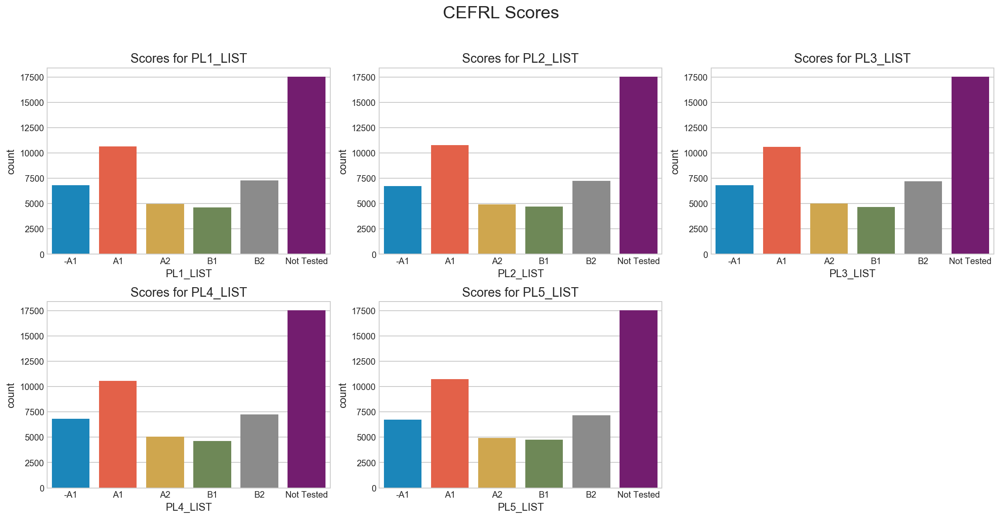

In [32]:
# plot listening scores
scores_fig(listening_cat)

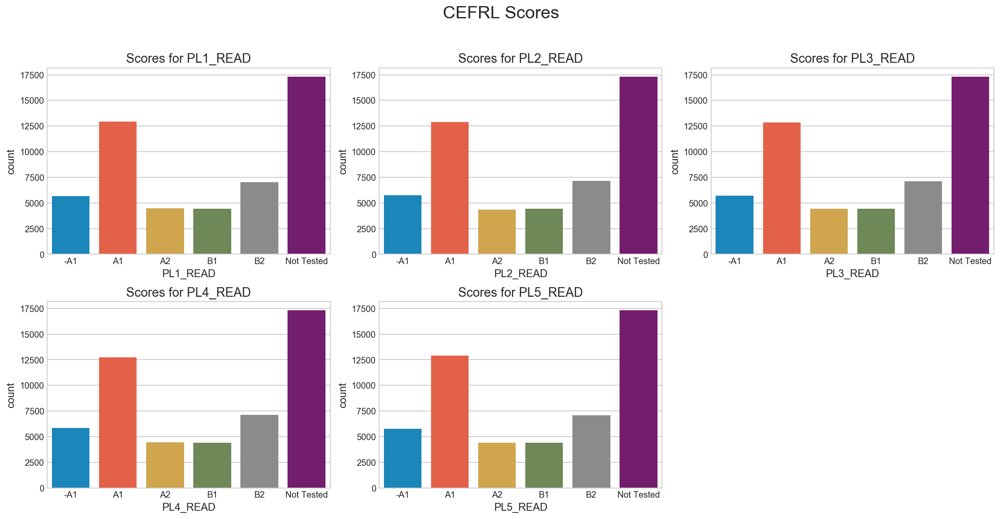

In [33]:
# plot reading scores
scores_fig(reading_cat)

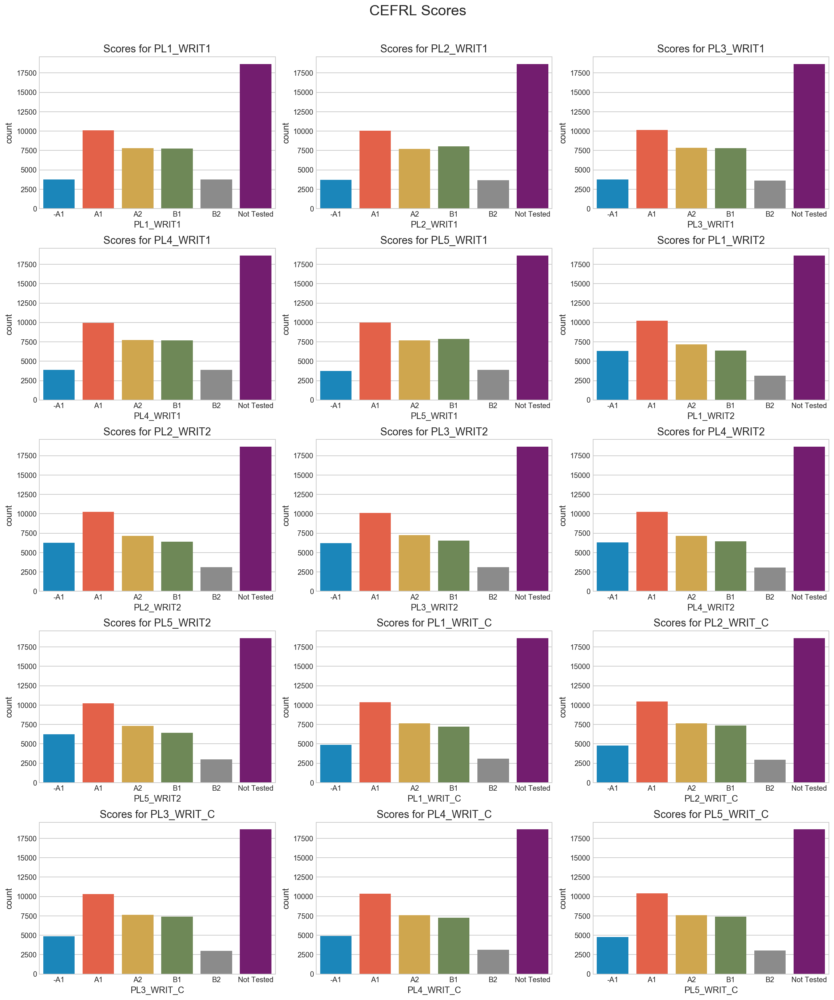

In [34]:
# plot writing scores
scores_fig(writing_cat)

DECISION
- The distribution of results across each class is close enough that I  believe I can get meaningful results by combining all columns for the same discipline into a single result per discipline. I will work on this basis for the categorical results and aim to have four targets in the categorical model: Listening, Reading, Writing and Combined.
- The 0 values here indicate the students who were not tested on a particular discipline. I have considered imputing these values proportionally with the other result classes but as I am looking to predict these values with my model, I feel that making assumptions about the target values could undermine my predictions so instead, I will use data only for the students with actual test results for each discipline. 

## Single Result Target per Discipline

In [35]:
# function to populate one column with most common result for each discipline
def find_mode_old(row, discipline):
    level_dict_old = {'-A1':0, 'A1':0, 'A2':0, 'B1':0, 'B2':0, 'Not Tested':0}
    for col in discipline:
        result = row[col]
        level_dict_old[result]+=1
    max_val = max(level_dict_old.values())
    tied = [key for key,val in level_dict_old.items() if val==max_val]
    mode = np.random.choice(tied)
    return mode

In [36]:
# function to populate one column with most common result for each discipline
def find_mode_overall(row, discipline):
    level_dict_overall = {'-A1':0, 'A1':0, 'A2':0, 'B1':0, 'B2':0, 'Not Tested':0}
    for col in discipline:
        result = row[col]
        level_dict_overall[result]+=1
    level_dict_overall.pop('Not Tested')
    max_val = max(level_dict_overall.values())
    tied = [key for key,val in level_dict_overall.items() if val==max_val]
    mode = np.random.choice(tied)
    return mode

In [37]:
# this is a combined function which I want to use to replace the two above but
# I'm debugging it at the moment

# function to populate one column with most common result for each discipline
def find_mode(row, discipline, overall=False):
    level_dict = {'-A1':0, 'A1':0, 'A2':0, 'B1':0, 'B2':0, 'Not Tested':0}
    for row in discipline:
        result = row[col]
        level_dict[result]+=1
    if overall:
        level_dict.pop('Not Tested')
    max_val = max(level_dict.values())
    tied = [key for key,val in level_dict.items() if val==max_val]
    mode = np.random.choice(tied)
    return mode

In [38]:
# populate new columns with most common result for each discipline
lang['PL_LIST'] = lang.apply(find_mode_old, discipline=listening, axis=1)
lang['PL_READ'] = lang.apply(find_mode_old, discipline=reading, axis=1)
lang['PL_WRIT'] = lang.apply(find_mode_old, discipline=writing, axis=1)
lang['PL_ALL'] = lang.apply(find_mode_overall, discipline=combined, axis=1)

In [39]:
# drop individual results columns as these will be strongly correlated with my target variables
lang.drop(listening, axis=1, inplace=True)
lang.drop(reading, axis=1, inplace=True)
lang.drop(writing, axis=1, inplace=True)

In [40]:
lang.shape

(51861, 368)

## Fill NaNs

The variety of data in the survey means that it doesn't make sense to impute all missing values as the mean for that feature. After reviewing the features I will need to impute in several stages as follows:
- to_mean: numerical values which are either not categorical or where the class directly relates to the value
- to_mode: categorical values where the class represents a particular grouping which should be respected and where 0 represents a specific class which shouldn't be assumed to be true overall
- to_zero: any feature where 0 means that something isn't done or doesn't apply and where it makes more sense to assume that the question would have been answered if the answer had been positive

In [41]:
# columns to impute as mean
to_mean = ['I01_ST_M_S39A','I01_ST_M_S40A','I01_ST_M_S40B',\
           'I01_ST_M_S44A','I01_ST_M_S44B','I01_ST_M_S59A',\
           'I02_ST_M_S37A','I02_ST_M_S37B','I02_ST_M_S41A',\
           'I03_ST_A_S04A','I03_ST_A_S25A','I03_ST_A_S26A',\
           'I03_ST_A_S28A','I03_ST_A_S29A','I03_ST_A_S30A',\
           'I03_ST_A_S31A','I03_ST_A_S45A','I05_ST_A_S23A',\
           'I05_ST_A_S24A','I05_ST_M_S62A','I06_ST_M_S45A',\
           'I06_ST_M_S46A','I08_ST_A_S02A','I08_ST_A_S19B',\
           'I09_IN_M_S49A','I09_IN_M_S50A','I09_IN_M_S51A',\
           'I09_IN_M_S57A','I09_ST_M_S33B','I09_ST_M_S48A',\
           'I09_ST_M_S52B','I14_IN_A_S42A','MPARED','FPARED',\
           'PARED','ISEI_M','ISEI_F','HISEI','SQt29i01',\
           'SQt41i01','SQt42i01','SQt42i01C','SQt43i01',\
          'SQt43i01C','SQt44i01','SQt44i01C','SQt44i02',\
          'SQt44i02C','SQt44i03','SQt44i03C']

In [42]:
# columns to impute as mode
to_mode = ['I01_ST_M_S39B','I02_ST_M_S38A','I03_ST_A_S03A',\
           'I08_ST_A_S01A','I14_ST_A_S06A','I14_ST_A_S06B',\
           'I14_ST_A_S06C','I14_ST_M_S47A','SQt27i01','SQt32i02',\
           'SQt32i03','SQt32i04','SQt38i01','SQt48i01','SQt48i02',\
           'SQt48i03','SQt48i04','SQt48i05','SQt48i06','SQt48i07',\
           'SQt52i01','SQt52i02','SQt52i03','SQt52i04','SQt52i05',\
          'SQt52i06','SQt52i07','SQt54i01','SQt54i02','SQt54i03',\
           'SQt54i04','SQt54i05','SQt54i06','SQt55i01','SQt55i02',\
           'SQt55i03','SQt55i04','SQt55i05','SQt55i06','SQt56i01',\
           'SQt56i02','SQt61i01','SQt61i02','SQt61i03','SQt61i04',\
           'SQt61i05','SQt61i06','SQt61i07']

In [43]:
# columns to impute as zero
to_zero = ['I01_ST_M_S63A','I01_ST_M_S63B','I03_ST_A_S04B',\
           'I03_ST_A_S25B','I03_ST_A_S26B','I03_ST_A_S27B',\
           'I04_ST_M_S64A','I04_ST_M_S64B','I08_ST_A_S15A',\
           'I08_ST_M_S64A','I08_ST_M_S64B']

In [44]:
# list of SQ survey columns
sq_cols = [col for col in lang.columns if 'SQ' in col]

# SQ columns where it makes more sense to impute as 0
sq_not_zero = ['SQt27i01','SQt29i01','SQt32i02','SQt32i03','SQt32i04',\
           'SQt38i01','SQt41i01','SQt42i01','SQt42i01C', 'SQt43i01',\
           'SQt43i01C','SQt44i01','SQt44i01C','SQt44i02','SQt44i02C',\
           'SQt44i03','SQt44i03C','SQt48i01','SQt48i02','SQt48i03',\
           'SQt48i04','SQt48i05','SQt48i06','SQt48i07','SQt52i01',\
           'SQt52i02','SQt52i03','SQt52i04','SQt52i05','SQt52i06',\
           'SQt52i07','SQt54i01','SQt54i02','SQt54i03','SQt54i04',\
           'SQt54i05','SQt54i06','SQt55i01','SQt55i02','SQt55i03',\
           'SQt55i04','SQt55i05','SQt55i06','SQt56i01','SQt56i02',\
           'SQt61i01','SQt61i02','SQt61i03','SQt61i04','SQt61i05',\
           'SQt61i06','SQt61i07']

In [45]:
# add the sq cols that should be imputed as zero to to_zero list
for col in sq_cols:
    if col not in sq_not_zero:
        to_zero.append(col) 

In [46]:
len(to_zero), len(to_mode), len(to_mean)

(254, 48, 50)

In [47]:
# subset to columns to impute as mode/mean
mean_subset = lang.loc[:,to_mean]
mode_subset = lang.loc[:,to_mode]

In [48]:
# impute columns with mode
imp_mode = Imputer(strategy='most_frequent')
lang_mode = imp_mode.fit_transform(mode_subset)
lang_mode = pd.DataFrame(lang_mode, columns=mode_subset.columns)

In [49]:
# impute columns with mean
imp_mean = Imputer(strategy='mean')
lang_mean = imp_mean.fit_transform(mean_subset)
lang_mean = pd.DataFrame(lang_mean, columns=mean_subset.columns)

In [50]:
lang_mean.shape, lang_mode.shape

((51861, 50), (51861, 48))

In [51]:
# merge mean and mode dfs
lang2 = lang_mode.merge(lang_mean, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [52]:
remaining_cols = [col for col in lang.columns if col not in to_mean and col not in to_mode]

In [53]:
len(lang.columns) - (len(remaining_cols) + len(lang2.columns))

0

In [54]:
lang3 = lang.loc[:,remaining_cols]

In [55]:
lang = lang3.merge(lang2, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [56]:
lang.shape

(51861, 368)

In [57]:
# fill remaining NaN's with zeros
lang.fillna(0., inplace=True)

## Binarise target variables

The results are divided into 5 levels from -A1 to B2, with B2 being the highest. According to the Common European Framework of Reference for Languages against which these tests have been scoreds, B represents an 'Independent User' and A represents a 'Basic User'. As the aim of my project is to predict high performance in a language, I will binarise the target with levels B1 and B2 representing 'high performance'.  

In [58]:
# create binarised result columns
lang['Target_Listening'] = lang['PL_LIST'].map(lambda x: 1 if x == 'B1' or x == 'B2' else 0)
lang['Target_Reading'] = lang['PL_READ'].map(lambda x: 1 if x == 'B1' or x == 'B2' else 0)
lang['Target_Writing'] = lang['PL_WRIT'].map(lambda x: 1 if x == 'B1' or x == 'B2' else 0)
lang['Target_All'] = lang['PL_ALL'].map(lambda x: 1 if x == 'B1' or x == 'B2' else 0)

In [59]:
# save target variable columns as list
targets_cat = ['PL_LIST','PL_READ','PL_WRIT','PL_ALL']
targets_bin = ['Target_Listening','Target_Reading','Target_Writing','Target_All']

In [61]:
# save categorical result columns for multiclass modelling and drop from main df
multiclass = lang.loc[:,targets_cat]
lang.drop(targets_cat, axis=1, inplace=True)

In [ ]:
# export df
# set path to save csv
path='/Users/lizspiking/GeneralAssembly/DSI5-lessons/projects/project-capstone/'

# save df to csv
lang.to_csv(path + 'lang_0406.csv', sep=',', na_rep='', float_format=None,\
                 header=True, index=False, mode='w', encoding='UTF-8',\
                 compression=None, quoting=None, quotechar='"',\
                 line_terminator='\n', decimal='.')

## Extend Column Headers

Most of the columns in the dataset have coded headers which make it very difficult to understand what the column represents. I will append more descriptive text to the column headers to make the data easier to understand.

In [62]:
columns_expanded = ['',
'',
'',
'',
'',
'gender',
'home_location',
'first_language1',
'first_language_target',
'first_lang_non_indig1',
'first_lang_non_indig2',
'first_lang_non_indig4',
'first_lang_other_euro1',
'first_lang_other_euro2',
'grade',
'grade_clean',
'study_prog',
'empl_status_mother',
'empl_status_father',
'mother_highest_school_level',
'father_highest_school_level',
'birth_country',
'birth_country_mother',
'birth_country_father',
'years_in_country',
'desk_at_home',
'own_room',
'quiet_place_to_study',
'books_to_help',
'computer',
'educational_software',
'internet',
'dictionary',
'classic_literature',
'poetry_books',
'art_works',
'dishwasher',
'dvd_player',
'country_specific_item1',
'country_specific_item2',
'country_specific_item3',
'no_of_books',
'no_of_mobiles',
'no_of_tvs',
'no_of_computers',
'no_of_cars',
'no_of_bathrooms',
'own_computer',
'internet_access',
'printer',
'cd_dvd_writer',
'scanner',
'usb_stick',
'games_console',
'own_mp3_player',
'own_mobile',
'freq_computer_use_homework',
'freq_computer_use_lang',
'freq_computer_use_info',
'freq_computer_use_games',
'freq_computer_use_entertainment',
'freq_computer_use_contact',
'lang_home1',
'lang_home_target',
'lang_home_non_indig1',
'lang_home_non_indig2',
'lang_home_non_indig4',
'lang_home_other_euro',
'lang_home_other_non_euro',
'lang_used_at_home_indig1',
'lang_used_at_home_target',
'lang_used_at_home_non_indig1',
'lang_used_at_home_non_indig2',
'lang_used_at_home_non_indig4',
'lang_used_at_home_other_euro',
'lang_used_at_home_non_euro',
'target_lang_level_father',
'target_lang_level_mother',
'target_lang_relatives_in_country',
'target_lang_friends_in_country',
'target_lang_tourist_home_country',
'target_lang_people_in_residence',
'target_lang_internet',
'target_lang_holidays',
'target_lang_write_friends_freq',
'target_lang_speak_relatives_freq',
'target_lang_speak_friends_freq',
'target_language_speak_residence_freq',
'target_lang_speak_tourists_freq',
'target_lang_speak_internet_freq',
'target_lang_songs_freq',
'target_lang_movies_no_subtitles_freq',
'target_lang_movies_subtitles_freq',
'target_lang_tv_no_subtitles_freq',
'target_lang_tv_subtitles_freq',
'target_lang_games_freq',
'target_lang_books_freq',
'target_lang_mag_comic_freq',
'target_lang_website_freq',
'perceived_competence_people_country',
'target_lang_usefulness_travel',
'target_lang_usefulness_personal_life',
'target_lang_usefulness_education',
'target_lang_usefulness_work',
'target_lang_usefulness_getting_job',
'target_lang_usefulness_contact_foreigners',
'target_lang_usefulness_satisfaction',
'target_lang_usefulness_computers',
'target_lang_usefulness_reading',
'target_lang_usefulness_entertainment',
'enjoyment_maths',
'enjoyment_science',
'enjoyment_humanities',
'enjoyment_arts',
'enjoyment_questionnaire_lang',
'enjoyment_target_lang',
'enjoyment_other_langs',
'enjoyment_vocational_subjects',
'enjoyment_sports',
'usefulness_maths',
'usefulness_science',
'usefulness_humanities',
'usefulness_arts',
'usefulness_questionnaire_lang',
'usefulness_target_lang',
'usefulness_other_langs',
'usefulness_vocational_subjects',
'usefulness_sports',
'hw_time_maths',
'hw_time_science',
'hw_time_humanities',
'hw_time_arts',
'hw_time_questionnaire_lang',
'hw_time_target_lang',
'hw_time_other_langs',
'hw_time_vocational_subjects',
'hw_time_sports',
'first_widely_taught_lang_in_country',
'second_widely_taught_lang_in_country',
'third_widely_taught_lang_in_country',
'fourth_widely_taught_lang_in_country',
'fifth_widely_taught_lang_in_country',
'other_lang',
'lang_taught_3rd_ISCED2',
'lang_taught_2nd_ISCED2',
'lang_taught_1st_ISCED2',
'lang_taught_6th_ISCED1',
'lang_taught_5th_ISCED1',
'lang_taught_4th_ISCED1',
'lang_taught_3rd_ISCED1',
'lang_taught_2nd_ISCED1',
'lang_taught_1st_ISCED1',
'lang_taught_pre_1st_ISCED1',
'target_lang_taught_3rd_ISCED2',
'target_lang_taught_2nd_ISCED2',
'target_lang_taught_1st_ISCED2',
'target_lang_taught_6th_ISCED1',
'target_lang_taught_5th_ISCED1',
'target_lang_taught_4th_ISCED1',
'target_lang_taught_3rd_ISCED1',
'target_lang_taught_2nd_ISCED1',
'target_lang_taught_1st_ISCED1',
'target_lang_taught_pre_1st_ISCED1',
'freq_school_trips_target_lang_country',
'freq_school_trips_non_target_lang_country',
'freq_trips_family_target_lang_country',
'freq_trips_family_non_target_lang_country',
'freq_visits_from_school_class_target_lang',
'freq_visits_from_school_class_non_target_lang',
'freq_collab_schools_abroad',
'freq_lang_clubs',
'freq_lang_competitions',
'freq_european_day_of_langs',
'freq_extracurricular_lang_projects',
'freq_writing_students_abroad',
'freq_lang_field_trips',
'compulsory_target_lang_learning',
'freq_teacher_speaks_target_lang_whole_class',
'freq_teacher_speaks_target_lang_few_students',
'freq_students_speak_target_lang_to_teacher',
'freq_students_speak_target_lang_group_work',
'freq_students_speak_target_lang_before_whole_c',
'freq_target_lang_audio_materials_in_class',
'freq_target_lang_video_in_class',
'freq_target_lang_text_in_class',
'freq_target_lang_internet_in_class',
'freq_target_lang_computer_programmes_in_class',
'freq_target_lang_pc_labs',
'freq_target_lang_textbooks',
'freq_target_lang_books_fiction',
'freq_target_lang_lesson_materials',
'freq_group_work_target_lang',
'freq_indiv_work_target_lang',
'freq_group_students_speak_before_class_target_',
'freq_indiv_student_speaks_before_class_target_',
'freq_teacher_speaks_to_whole_class_target_lang',
'freq_teacher_speaks_to_few_students_target_lan',
'freq_emphasis_between_target_and_other_lang_wr',
'freq_emphasis_between_target_and_other_lang_sp',
'freq_emphasis_between_target_and_other_lang_un',
'freq_emphasis_between_target_and_other_lang_gr',
'freq_emphasis_between_target_and_other_lang_re',
'freq_emphasis_between_target_and_other_lang_pr',
'freq_emphasis_between_target_and_other_lang_vocab',
'freq_learning_writing_target_lang',
'freq_learning_speaking_target_lang',
'freq_learning_understanding_spoken_target_lang',
'freq_learning_grammar_target_lang',
'freq_learning_reading_target_lang',
'freq_learning_pronunciation_target_lang',
'freq_learning_vocab_target_lang',
'freq_test_target_lang',
'freq_feedback_on_assignments',
'time_spent_studying_for_tests',
'freq_computer_use_target_lang_info_finding',
'freq_computer_use_target_lang_homework',
'freq_computer_use_target_lang_writing',
'freq_computer_use_target_lang_speaking',
'freq_computer_use_target_lang_understanding_sp',
'freq_computer_use_target_lang_grammar',
'freq_computer_use_target_lang_reading',
'freq_computer_use_target_lang_pronunciation',
'freq_computer_use_target_lang_vocab',
'time_spent_homework_target_lang',
'time_spent_homework_other_langs',
'enrichment_lessons_target_lang',
'enrichment_lessons_other_langs',
'remedial_lessons_target_lang',
'remedial_lessons_other_langs',
'extra_lessons_questionnaire_lang',
'extra_lessons_not_questionnaire_lang_spoken_at',
'target_lang_can_understand_familiar_words_simp',
'target_lang_can_find_info_ads_timetables_reading',
'target_lang_can_find_main_points_simple_news_a',
'target_lang_can_read_long_complex_texts_locati',
'target_lang_can_understand_qs_instructions_if_',
'target_lang_can_understand_if_spoken_slowly_cl',
'target_lang_can_understand_radio_TV_programmes',
'target_lang_can_understand_long_complicated_le',
'target_lang_can_write_few_words_phrases_relati',
'target_lang_can_write_basic_description_of_events',
'target_lang_can_write_detailed_letters_relatin',
'target_lang_can_write_detailed_review_film_boo',
'target_lang_can_ask_answer_simple_questions_fa',
'target_lang_can_tell_simple_story',
'target_lang_can_maintain_conversation_familiar',
'target_lang_can_explain_viewpoint_advantages_d',
'occupation_mother',
'occupation_father',
'home_possessions',
'target_lang_learning_time_homework',
'foreign_lang_learning_time_homework',
'target_lang_first_lang',
'target_lang_exposure_home',
'target_lang_used_home',
'target_lang_most_spoken_lang_home',
'target_lang_enrichment_remedial_lessons',
'foreign_lang_enrichment_remedial_lessons',
'immigration_background',
'received_help_mastering_host_lang',
'received_formal_education_lang_of_origin',
'',
'',
'',
'',
'',
'onset_FL_education',
'first_lang_studied_school',
'home_location',
'gender',
'programme_level',
'program_designation',
'programme_orientation_clean',
'compulsory_target_lang_learning',
'home_lang_most_used',
'perceived_competence_father',
'perceived_competence_mother',
'perceived_competence_self',
'first_foreign_lang_learnt_school',
'perceived_difficulty_target_lang_writing',
'perceived_difficulty_target_lang_speaking',
'perceived_difficulty_target_lang_understanding',
'perceived_difficulty_target_lang_grammar',
'perceived_difficulty_target_lang_reading',
'perceived_difficulty_target_lang_pronunciation',
'perceived_difficulty_target_lang_vocab',
'perceived_usefulness_for_writing_target_lang_t',
'perceived_usefulness_for_speaking_target_lang_',
'perceived_usefulness_for_understanding_target_',
'perceived_usefulness_for_grammar_target_lang_t',
'perceived_usefulness_for_reading_target_lang_t',
'perceived_usefulness_for_pronunciation_target_',
'perceived_usefulness_for_vocab_target_lang_tex',
'perception_target_lang_teacher_is_good',
'perception_target_lang_teacher_get_along',
'perception_target_lang_teacher_makes_effort_in',
'perception_target_lang_teacher_helpful',
'perception_target_lang_teacher_like',
'perception_target_lang_teacher_strict',
'perception_target_lang_lessons_interesting',
'perception_target_lang_lessons_enjoyable',
'perception_target_lang_lessons_good',
'perception_target_lang_lessons_waste_of_time',
'perception_target_lang_lessons_easy',
'perception_target_lang_lessons_boring',
'perceived_difficulty_learning_target_lang_usua',
'perceived_difficulty_learning_target_lang_stud',
'perceived_importance_for_target_lang_final_gra',
'perceived_importance_for_target_lang_final_gra',
'perceived_importance_for_target_lang_final_gra',
'perceived_importance_for_target_lang_final_gra',
'perceived_importance_for_target_lang_final_gra',
'perceived_importance_for_target_lang_final_gra',
'perceived_importance_for_target_lang_final_gra',
'duration_FL_education',
'duration_TL_education',
'onset_TL_education',
'target_lang_lesson_time_week',
'foreign_lang_lesson_time_week',
'target_lang_learning_time_tests',
'no_ancient_foreign_langs_learnt',
'no_modern_foreign_langs_learnt',
'no_langs_studied_before_target_lang',
'no_first_languages',
'no_langs_at_home_exposure',
'no_langs_at_home_use',
'target_lang_parents_knowledge',
'target_lang_exposure_through_home_env',
'target_lang_use_through_home_env',
'target_lang_exposure_use_through_media',
'target_lang_exposure_use_visits_abroad',
'ICT_facilities_at_home',
'freq_ICT_use_outside_school',
'freq_ICT_use_lang_learning',
'received_opportunities_target_lang_exchange_vi',
'received_opportunities_target_lang_school_proj',
'age',
'economic_social_cultural_status',
'teachers_use_target_lang_during_foreign_lang_l',
'students_use_target_lang_during_foreign_lang_l',
'resource_use_target_lang_lessons',
'perceived_emphasis_similarities_between_known_',
'indicator_for_perception_usefulness_target_lan',
'perceived_difficulty_target_lang_learning',
'indicator_perception_target_lang_lessons_teach',
'class_size',
'mother_education_years',
'father_education_years',
'highest_parental_education_years',
'socio_economic_index_occupation_mother',
'socio_economic_index_occupation_father',
'highest_occupational_status',
'target_lang_exposure_penfriend',
'no_langs_studied_pre_target_lang',
'class_size',
'class_size_clean',
'class_duration',
'class_duration_clean',
'target_lang_classes_per_week',
'target_lang_classes_per_week_clean',
'lang_classes_per_week',
'lang_classes_per_week_clean',
'total_classes_per_week',
'total_classes_per_week_clean',
'','','','']

In [63]:
# compare number of columns in df against columns_expanded
len(columns_expanded), len(lang.columns)

(368, 368)

In [64]:
# update df column names to include expanded description for clarity
lang.columns = [col + '_' + expanded for col,expanded in zip(lang.columns,columns_expanded)]

In [65]:
# clean trailing underscores from column headers
lang.columns = lang.columns.str.rstrip('_')

## ICT (Information and Communications Technology)

In [66]:
# group ICT-related features together
ict = [col for col in lang.columns if 'ICT' in col or 'computer' in col]

In [67]:
# function to plot response data for multiple features
def features_fig(data):
    # create figure to hold multiple plots  
    plt.figure(figsize=(16,30))

    # instantiate the variable for the location of the first subplot 
    j = 1

    # iterate through columns in list and create subplot for the scores in each
    for i in data.columns:
        data.sort_values(i, axis=0, ascending=True, inplace=True)
        plt.subplot(10,3,j)
        plt.title('Responses for ' + str(i), fontsize=15)
        sns.countplot(x=i, data=data)
        #plt.set_ylabel('Frequency')
        plt.xticks(rotation=90)
        j += 1

    plt.tight_layout(rect=[0,0.03,1,0.95])
    plt.suptitle('Feature Distributions', fontsize=20)
    plt.show()

In [68]:
# save ict data
ict_df = lang.loc[:,ict]

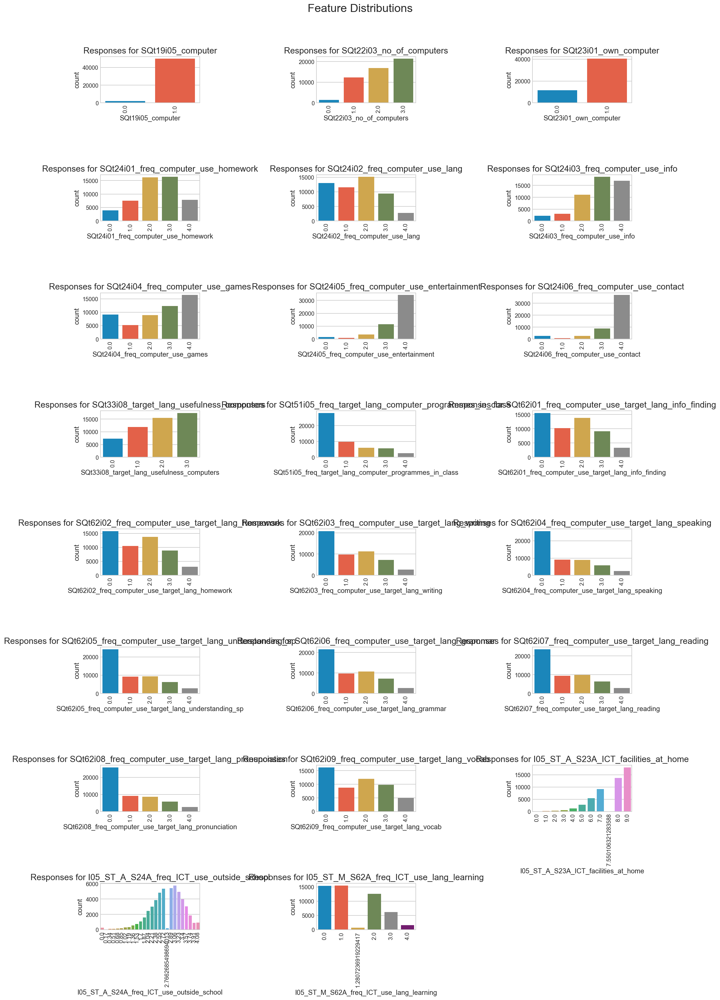

In [69]:
features_fig(ict_df)

In [74]:
# set targets df to merge with feature-specific DFs for correlation matrices
targets_df = lang.loc[:,targets_bin].copy()

In [75]:
ict_df = ict_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [76]:
ict_corr = ict_df.corr()

In [77]:
# heatmap function to compare correlations
def heatmap_func(data):
    fig,ax = plt.subplots(figsize=(25,25))
    sns.set(font_scale=1.2)

    mask = np.zeros_like(data, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True

    ax = sns.heatmap(data, ax=ax, cmap='coolwarm', center=0, annot=True, mask=mask);

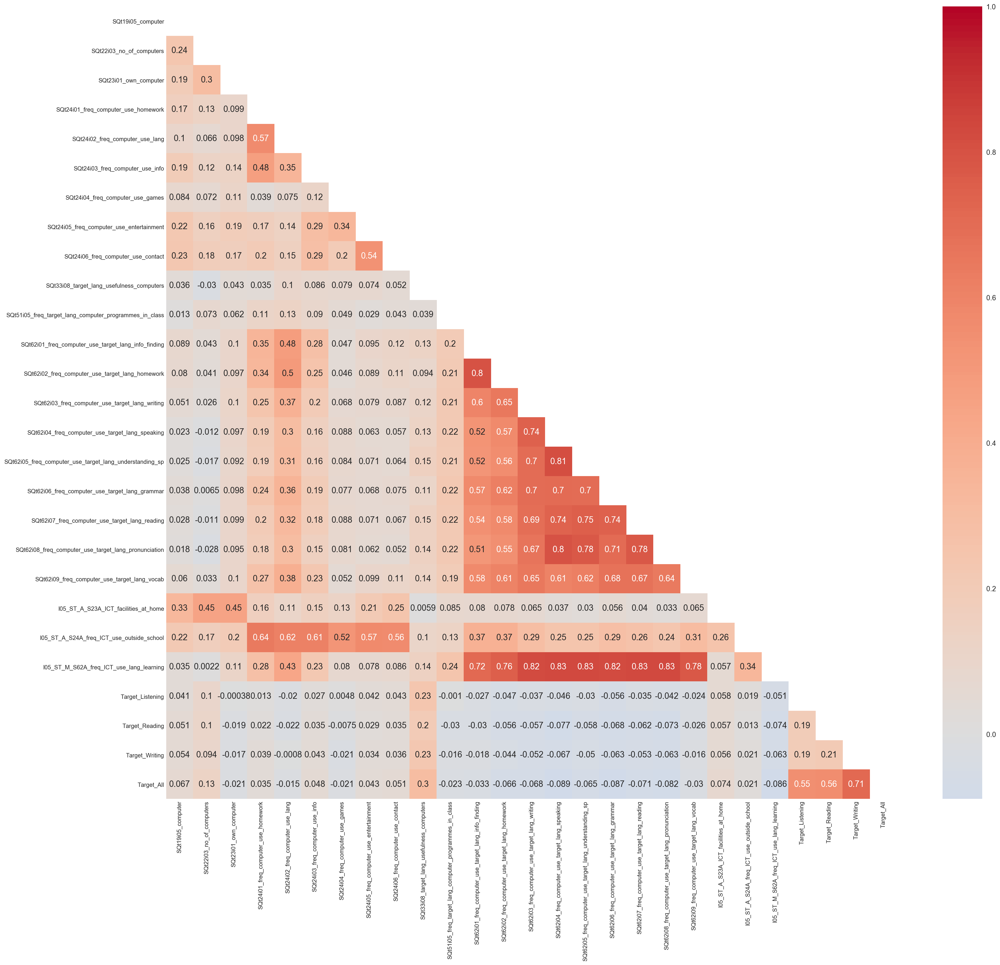

In [78]:
heatmap_func(ict_corr)

## Time Spent Studying

In [79]:
# group time spent studying-related features together
study = [col for col in lang.columns if 'hw_time' in col\
         or 'time_spent' in col]

In [80]:
study_df = lang.loc[:,study]

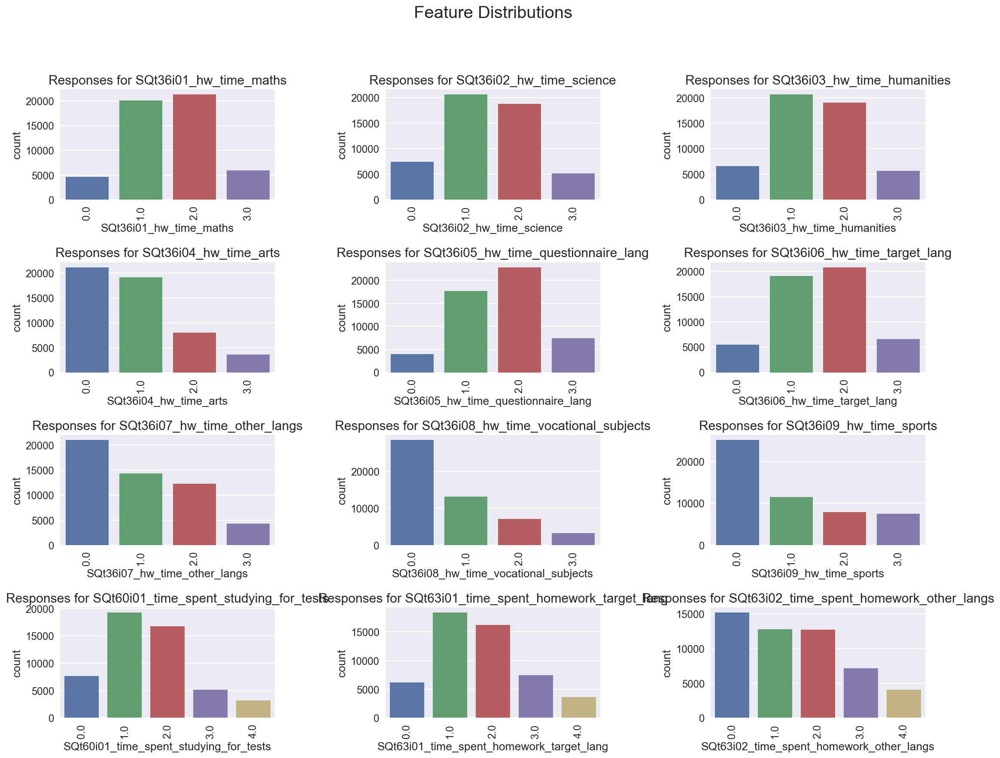

In [81]:
features_fig(study_df)

In [82]:
study_df = study_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [83]:
study_corr = study_df.corr()

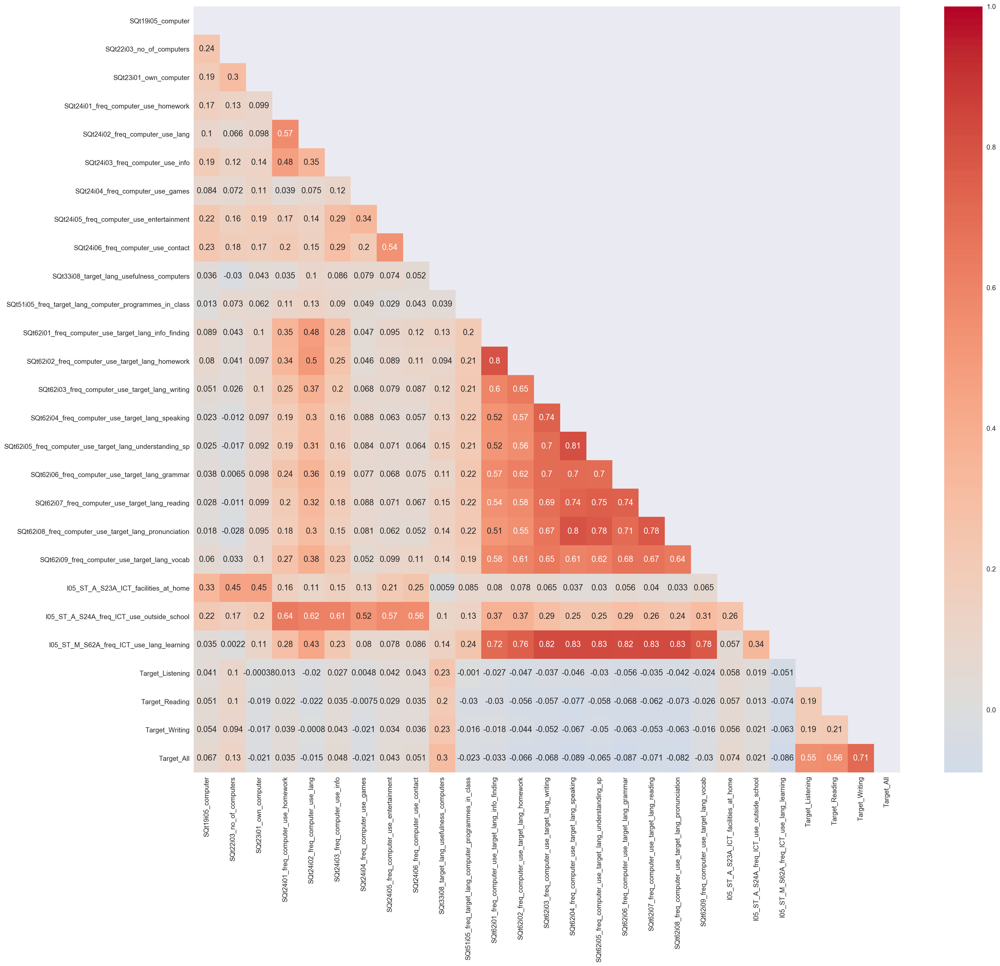

In [84]:
heatmap_func(ict_corr)

## Target Language-Specific Features

In [85]:
# group target language-related features together
TL_list = [col for col in lang.columns if 'TL' in col\
           or 'target_language' in col or 'target_lang' in col]

In [86]:
len(TL_list)

168

In [87]:
TL_df = lang.loc[:,TL_list]

In [88]:
#features_fig(TL_df)

In [89]:
TL_df = TL_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [90]:
TL_corr = TL_df.corr()

In [91]:
#heatmap_func(TL_corr)

#### Action
These charts and the ones below take ages to run/need reformatting so I am leaving them out of the submission just because I'm already so behind! I will sort out proper charts before publishing.

## Foreign Language-Specific Features

In [92]:
# group foreign language-related features together
FL_list = [col for col in lang.columns if 'FL' in col\
           or 'foreign_language' in col or 'foreign_lang' in col]

In [93]:
FL_df = lang.loc[:,FL_list]

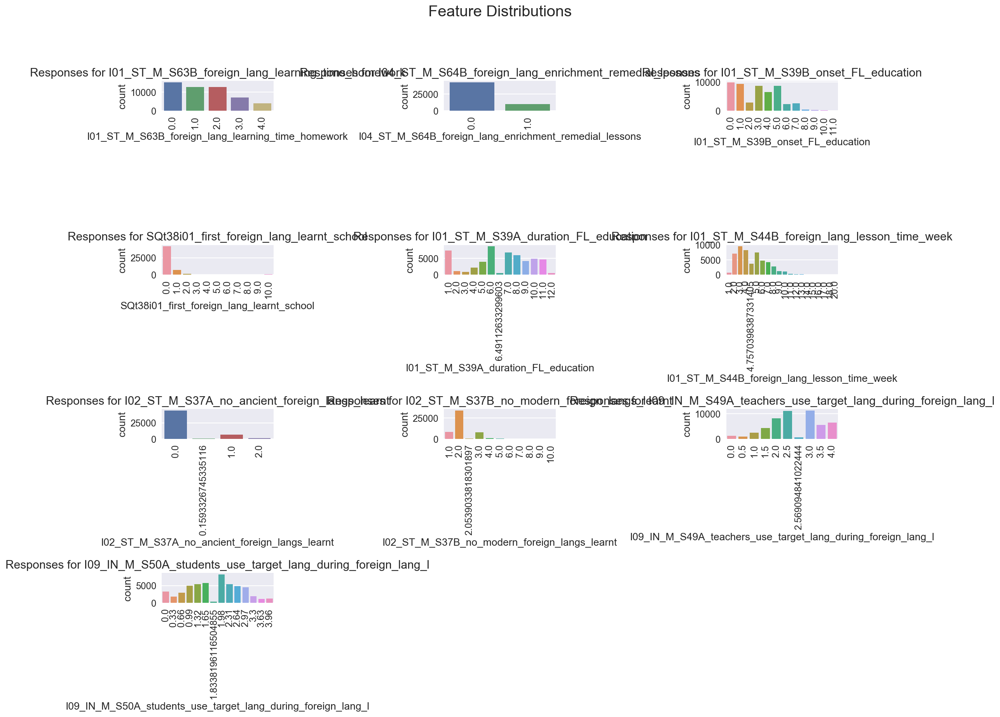

In [94]:
features_fig(FL_df)

In [95]:
FL_df = FL_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [96]:
FL_corr = FL_df.corr()

In [97]:
# heatmap function to compare correlations on fewer features
def small_heatmap_func(data):
    fig,ax = plt.subplots(figsize=(8,8))
    sns.set(font_scale=0.8)

    mask = np.zeros_like(data, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True

    ax = sns.heatmap(data, ax=ax, cmap='coolwarm', center=0, annot=True, mask=mask);

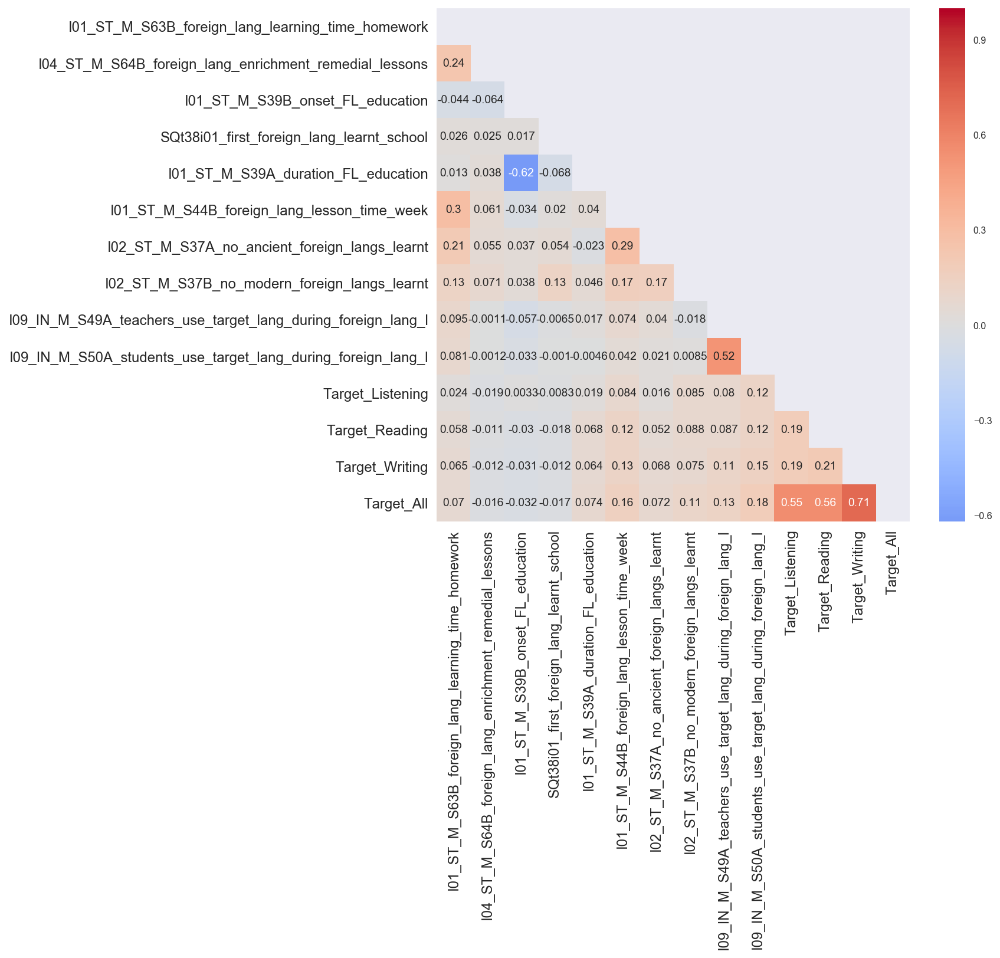

In [98]:
small_heatmap_func(FL_corr)

## Enjoyment

In [99]:
# group enjoyment-related features together
enjoyment = [col for col in lang.columns if 'enjoyment' in col]

In [100]:
enjoyment_df = lang.loc[:,enjoyment]

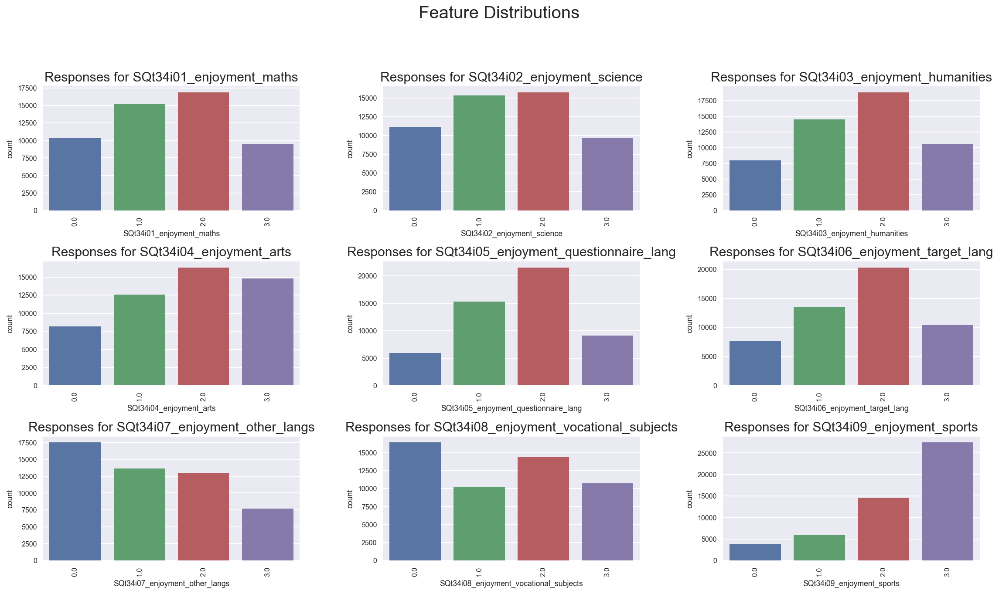

In [101]:
features_fig(enjoyment_df)

In [102]:
enjoyment_df = enjoyment_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [103]:
enjoyment_corr = enjoyment_df.corr()

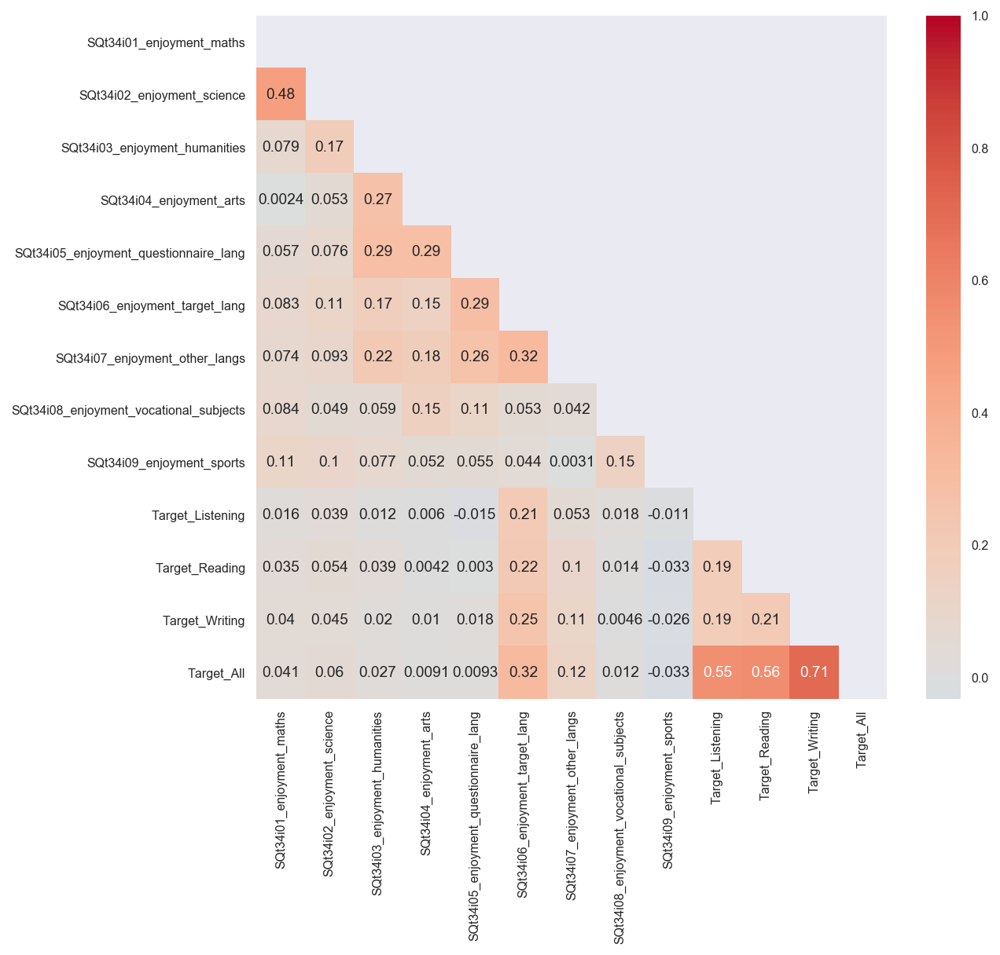

In [104]:
small_heatmap_func(enjoyment_corr)

## Perceived Difficulty

In [105]:
# group difficulty-related features together
difficulty = [col for col in lang.columns if 'difficulty' in col]
len(difficulty)

10

In [106]:
difficulty_df = lang.loc[:,difficulty]

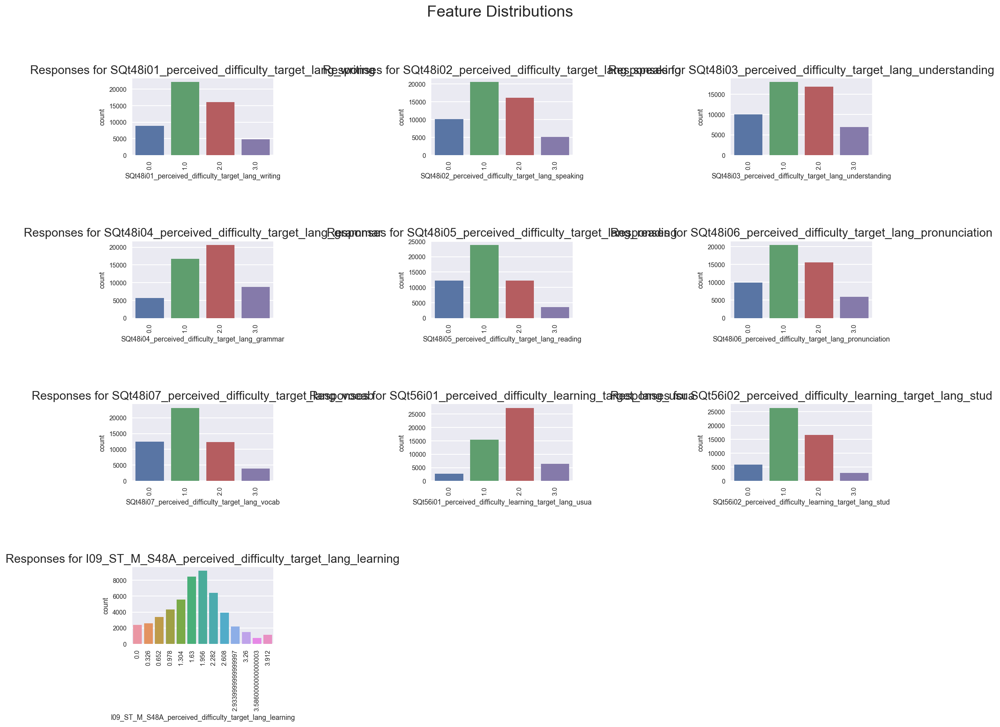

In [107]:
features_fig(difficulty_df)

#### Action
I need to amend the figsize for these charts and sort out the tick labels for the last feature.

In [108]:
difficulty_df = difficulty_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [109]:
difficulty_corr = difficulty_df.corr()

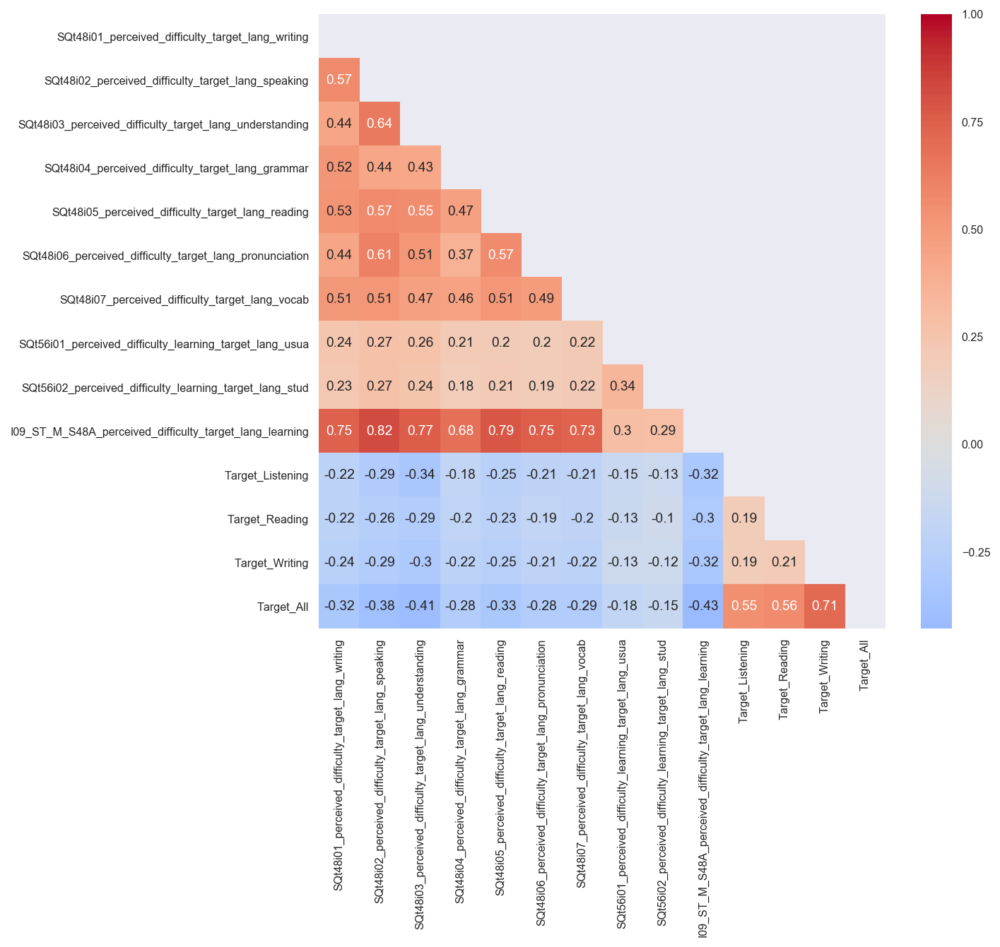

In [167]:
small_heatmap_func(difficulty_corr)

## Perceived Importance

In [168]:
# group perceived importance-related features together
importance = [col for col in lang.columns if 'importance' in col]

In [169]:
importance_df = lang.loc[:,importance]

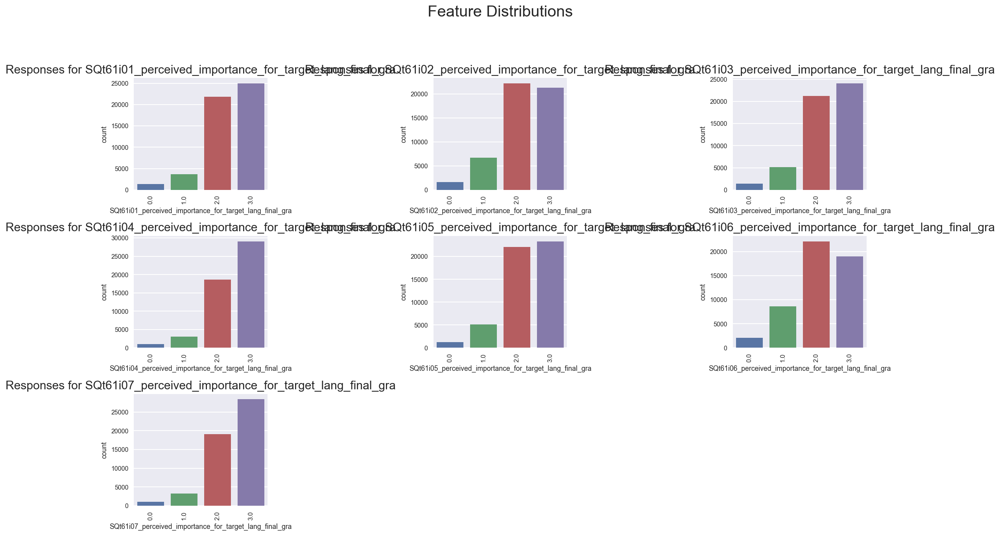

In [170]:
features_fig(importance_df)

#### Action
Sort out figsize/formatting.

In [171]:
importance_df = importance_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [172]:
importance_corr = importance_df.corr()

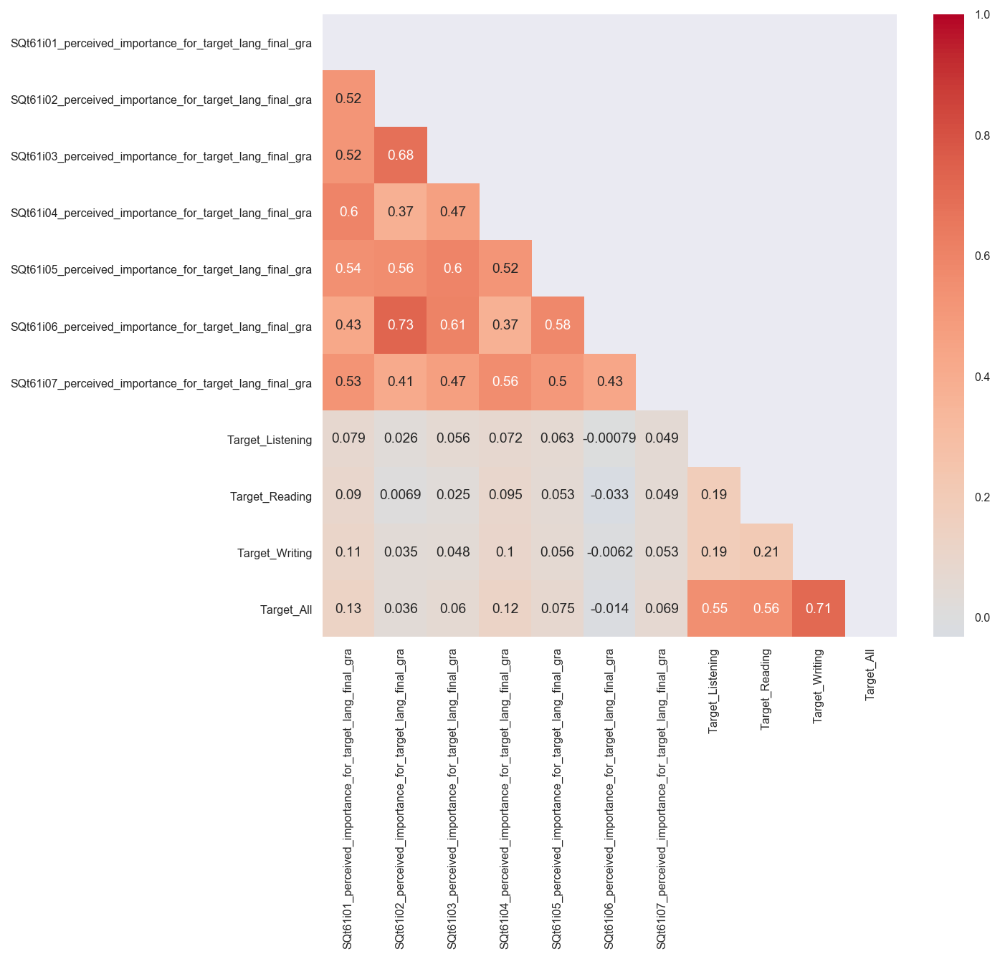

In [173]:
small_heatmap_func(importance_corr)

## Onset of Language Teaching

In [117]:
# group features related to the onset of language teaching together
onset = [col for col in lang.columns if 'lang_taught' in col\
         or 'language_taught' in col or 'onset' in col]

In [118]:
onset_df = lang.loc[:,onset]

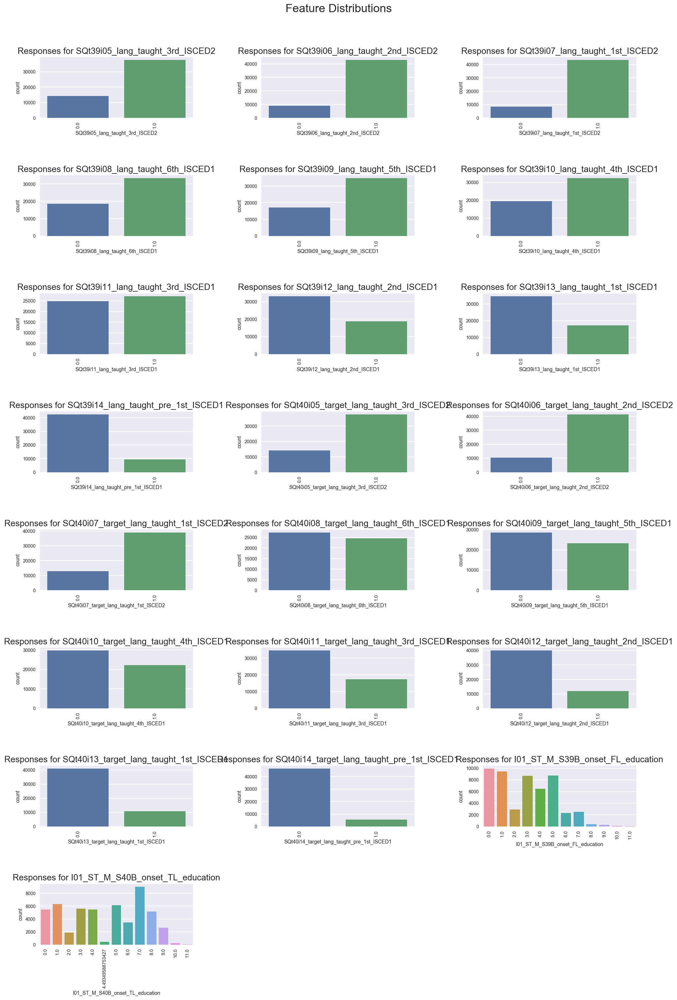

In [119]:
features_fig(onset_df)

In [120]:
onset_df = onset_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [121]:
onset_corr = onset_df.corr()

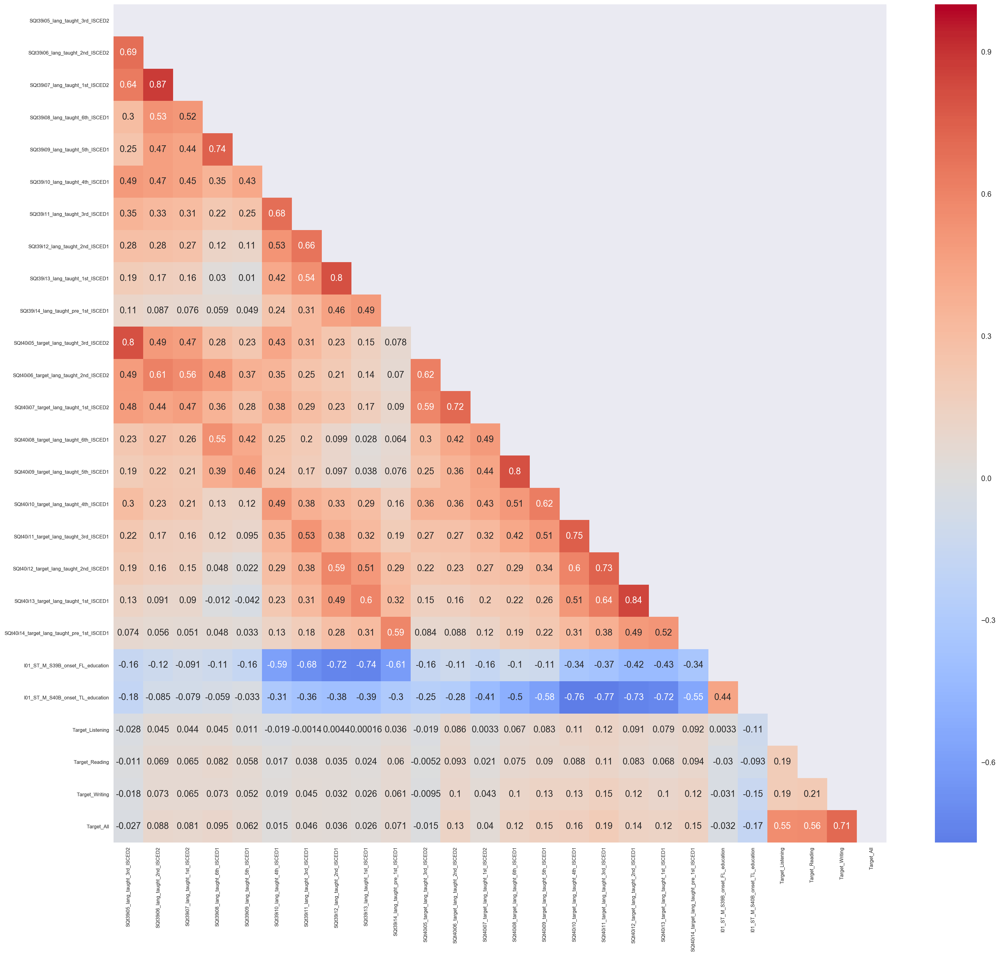

In [122]:
heatmap_func(onset_corr)

## Socio-Economic Factors

In [123]:
# group home features together
home = [col for col in lang.columns if 'no_of' in col]

In [124]:
home_df = lang.loc[:,home]

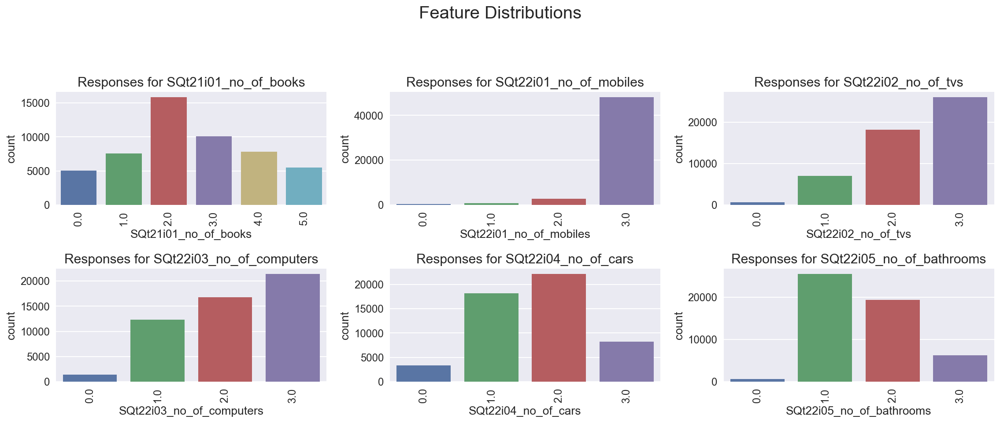

In [125]:
features_fig(home_df)

In [126]:
# function to plot response data for higher number of classes
def classes_fig(data):
    # create figure to hold multiple plots  
    plt.figure(figsize=(16,10))

    # instantiate the variable for the location of the first subplot 
    j = 1

    # iterate through columns in list and create subplot for the scores in each
    for i in data.columns:
        data.sort_values(i, axis=0, ascending=True, inplace=True)
        plt.subplot(2,1,j)
        plt.title('Responses for ' + str(i), fontsize=15)
        sns.countplot(x=i, data=data)
        #plt.set_ylabel('Frequency')
        plt.xticks(rotation=90)
        j += 1

    plt.tight_layout(rect=[0,0.03,1,0.95])
    plt.suptitle('Feature Distributions', fontsize=20)
    plt.show()

In [127]:
socio_ec = [col for col in lang.columns if 'socio_economic' in col]

In [128]:
socio_ec_df = lang.loc[:,socio_ec]

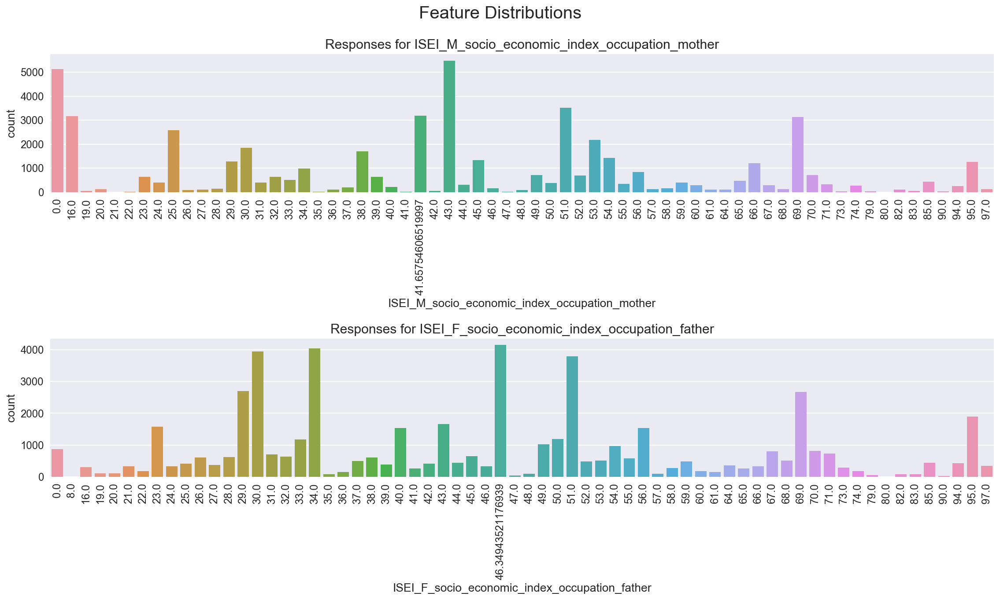

In [129]:
classes_fig(socio_ec_df)

## Parents' Occupations

In [130]:
# convert descriptions to title case
lang.ISCO_M_description = lang.ISCO_M_description.str.title()
lang.ISCO_F_description = lang.ISCO_F_description.str.title()

In [131]:
# group occupations together
occupation = [col for col in lang.columns if 'description' in col\
              and 'ISCO' in col]

In [132]:
# function to plot response data for higher number of classes
def occupations_fig(data):
    # create figure to hold multiple plots  
    plt.figure(figsize=(16,150))
    
    # instantiate the variable for the location of the first subplot 
    j = 1

    # iterate through columns in list and create subplot for the scores in each
    for i in data.columns:
        data.sort_values(i, axis=0, ascending=True, inplace=True)
        plt.subplot(2,1,j)
        plt.title('Responses for ' + str(i), fontsize=15)
        sns.countplot(y=i, data=data, orient='h', order = data[i].value_counts().index)
        #plt.set_ylabel('Frequency')
        plt.xticks(rotation=90)
        j += 1

    plt.tight_layout(rect=[0,0.03,1,0.95])
    plt.suptitle('Feature Distributions', fontsize=20)
    plt.show()

In [133]:
occupations_df = lang.loc[:,occupation]

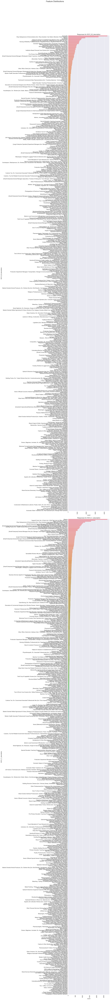

In [134]:
occupations_fig(occupations_df)

In [135]:
socio_ec_df = socio_ec_df.merge(home_df, how='left', left_index=True, right_index=True,suffixes=('', ''))
socio_ec_df = socio_ec_df.merge(occupations_df, how='left', left_index=True, right_index=True,suffixes=('', ''))
socio_ec_df = socio_ec_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [136]:
socio_ec_corr = socio_ec_df.corr()

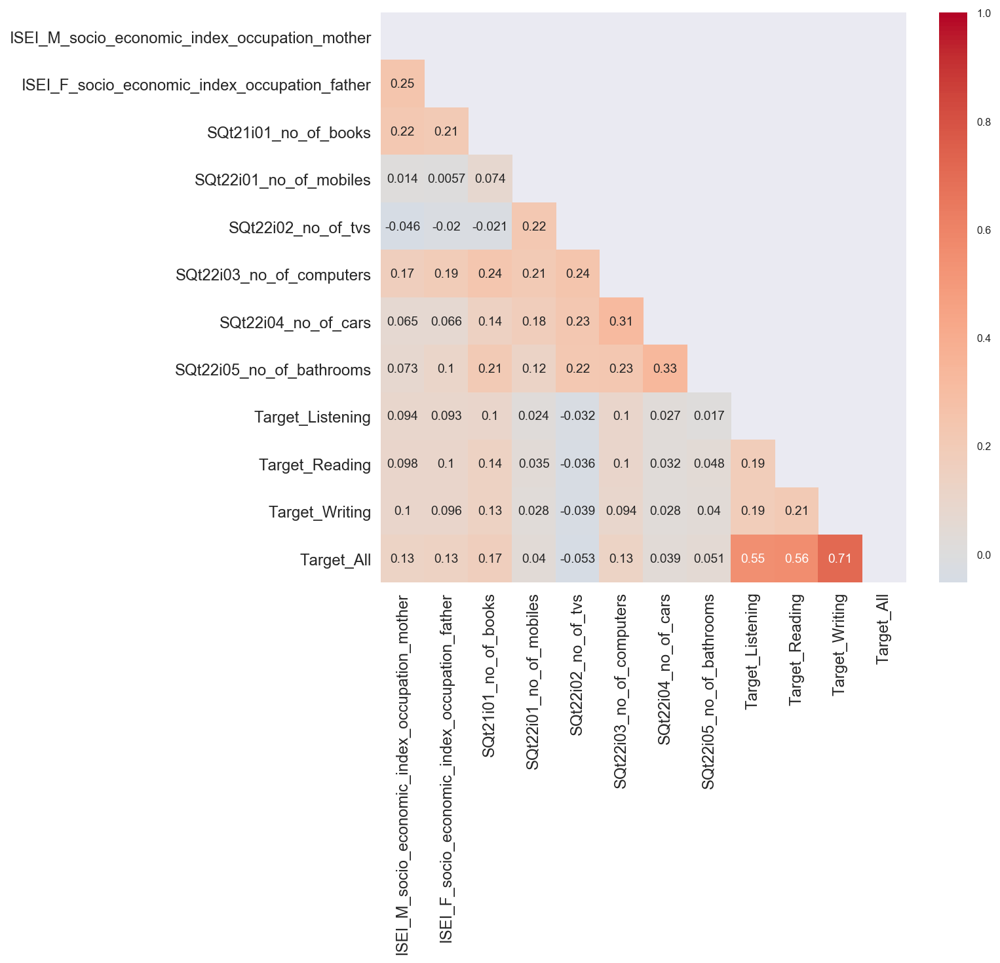

In [137]:
small_heatmap_func(socio_ec_corr)

## Language Trips

In [138]:
# group language trips/exchanges together
trips = [col for col in lang.columns if 'trip' in col\
         or 'exchange' in col or 'visit' in col]

In [139]:
trips_df = lang.loc[:,trips]

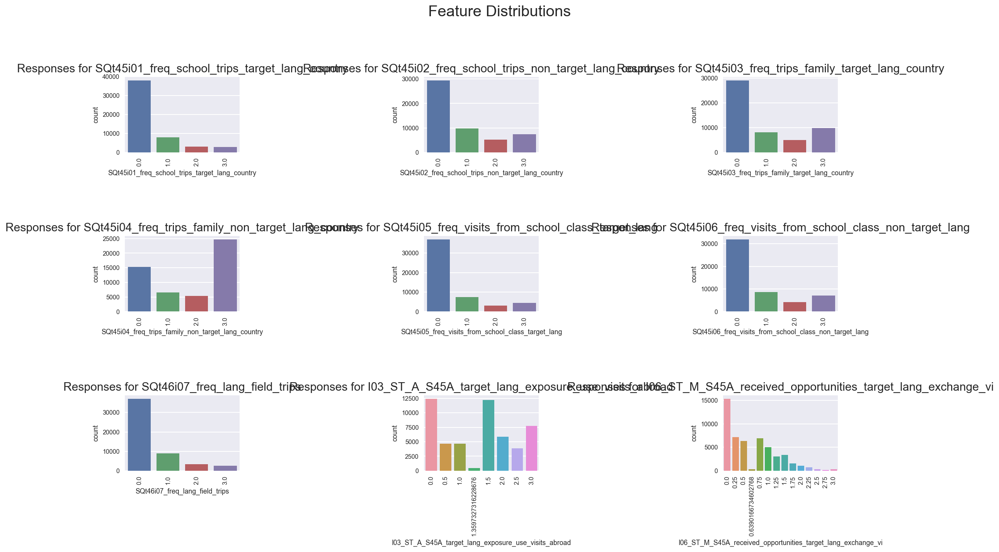

In [140]:
features_fig(trips_df)

In [141]:
trips_df = trips_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [142]:
trips_corr = trips_df.corr()

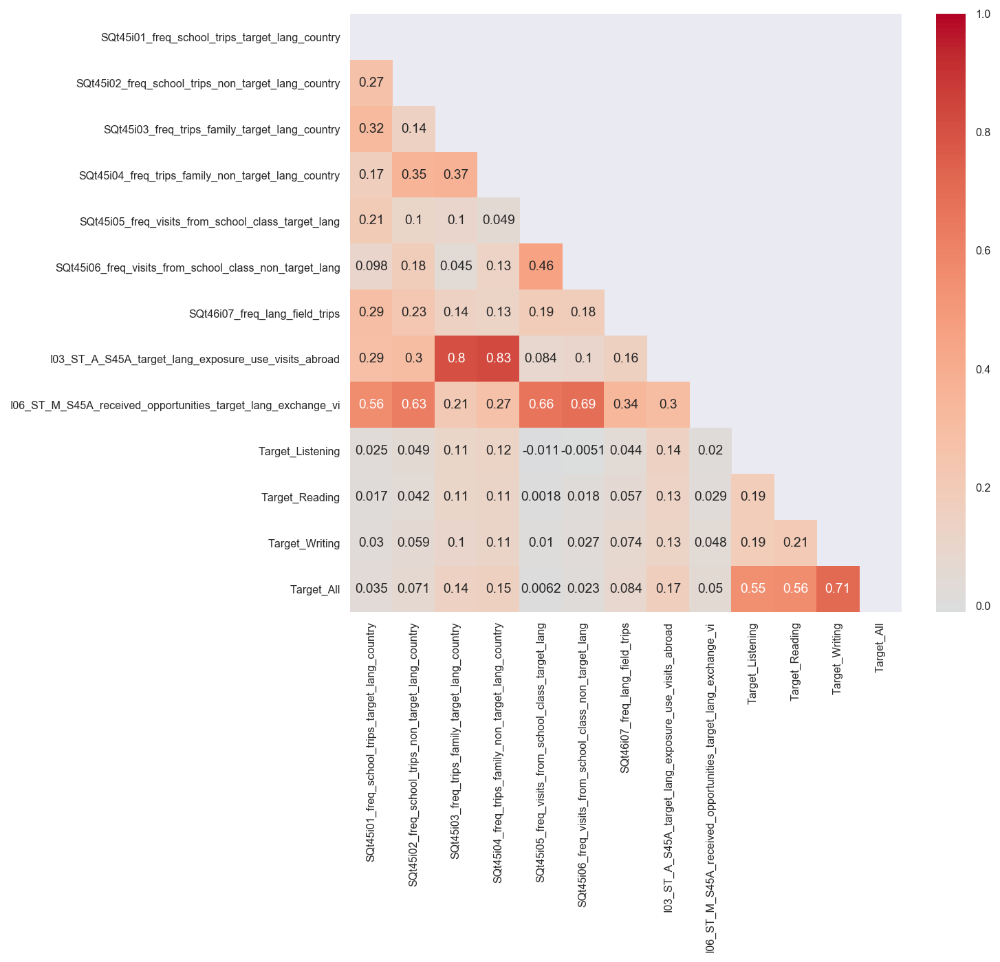

In [143]:
small_heatmap_func(trips_corr)

## Parental Influence

I am interested to understand whether a parent's education level, employment status or language knowledge has any bearing on their children's ability to learn a language, irrespective of whether they have raised their child as multilingual.

In [144]:
# group features relating to parents' language knowledge together
parent = [col for col in lang.columns if 'mother' in col\
          or 'father' in col or 'parent' in col\
          and 'occupation' not in col]

In [145]:
# pop occupation features from the list
parent2 = [col for col in parent if 'occupation' not in col]

#### Action
Find better way of excluding occupation from this list.

In [146]:
parent_df = lang.loc[:,parent2]

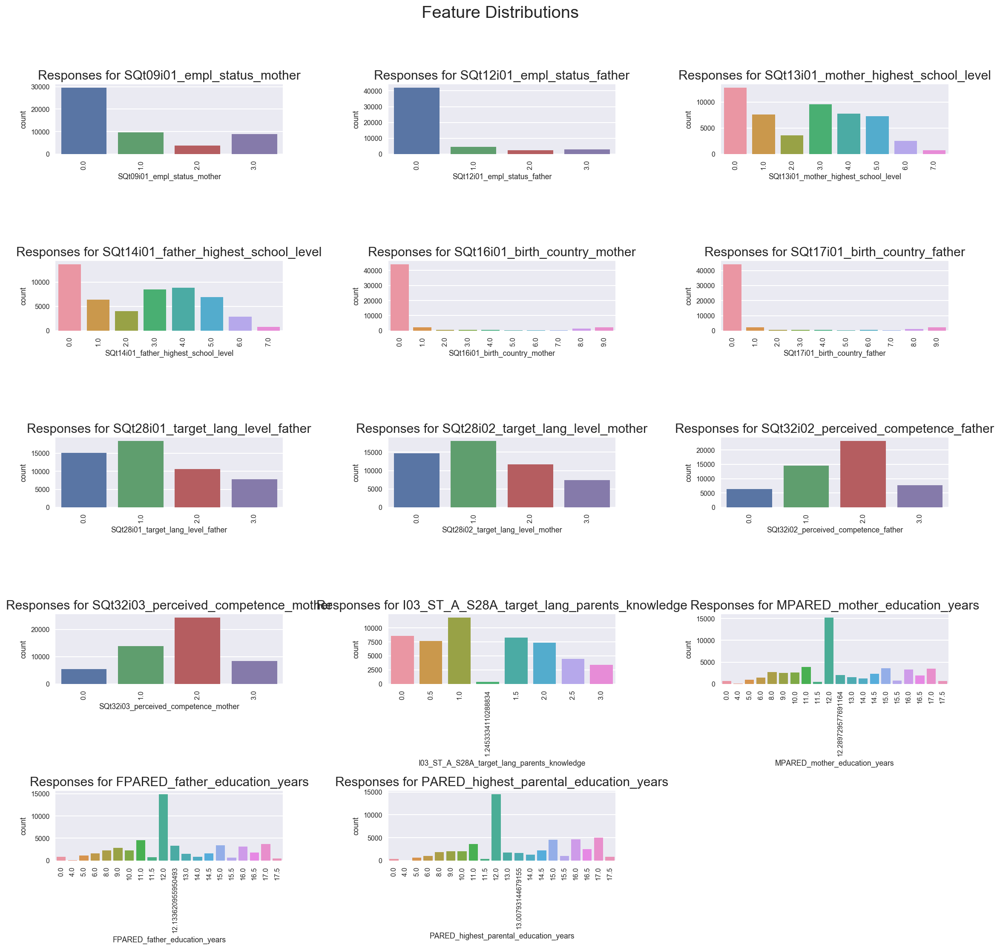

In [147]:
features_fig(parent_df)

In [148]:
parent_df = parent_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [149]:
parent_corr = parent_df.corr()

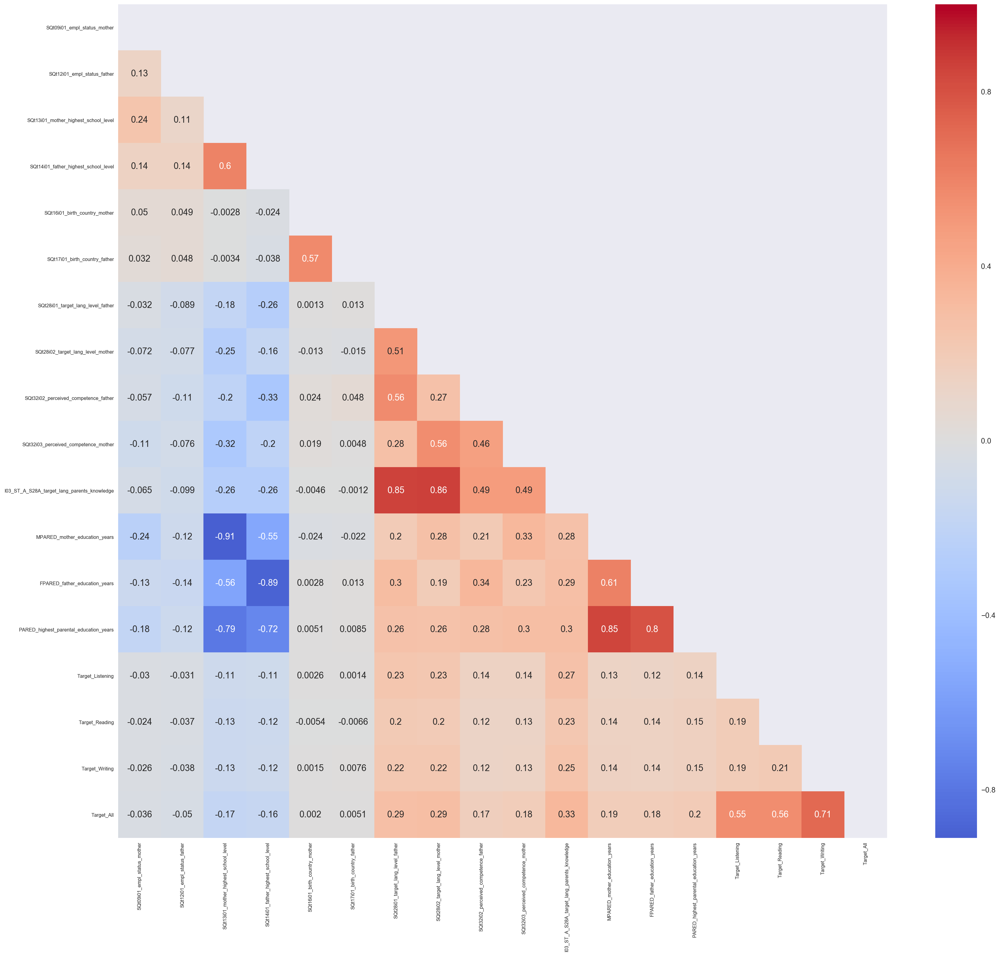

In [150]:
heatmap_func(parent_corr)

## Perceived Usefulness (only run when time!)

In [151]:
# group usefulness-related features together
usefulness = [col for col in lang.columns if 'usefulness' in col]

In [152]:
len(usefulness)

27

In [153]:
usefulness_df = lang.loc[:,usefulness]

In [154]:
# takes ages so I need to understand why before including it
#features_fig(usefulness_df)

In [155]:
usefulness_df = usefulness_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [156]:
usefulness_corr = usefulness_df.corr()

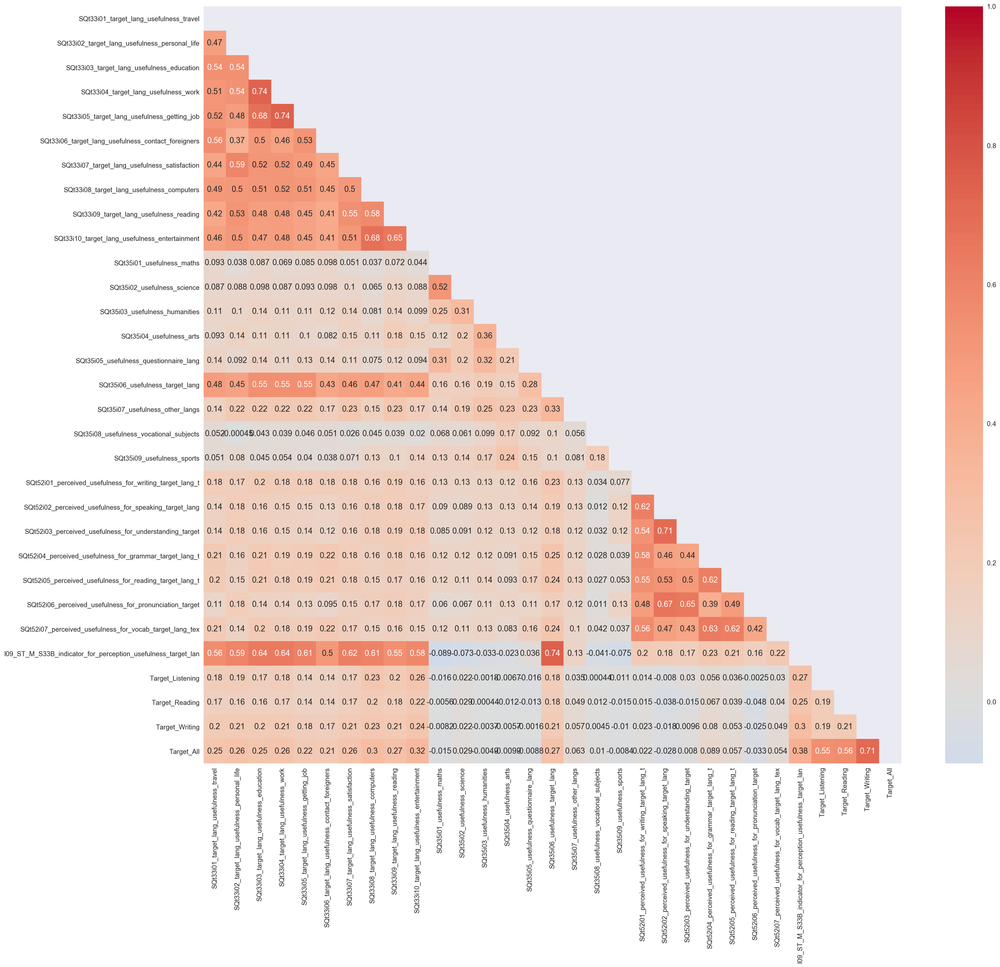

In [157]:
heatmap_func(usefulness_corr)

## Language Competence by Country

In [158]:
countries = lang.groupby('country')[['Target_Listening', 'Target_Reading', 'Target_Writing', 'Target_All']].sum()

In [159]:
countries.head()

,Target_Listening,Target_Reading,Target_Writing,Target_All
country,,,,
Belgium (Flemish),1368,1357,1239,1932
Belgium (French),437,470,479,700
Belgium (German),571,503,529,812
Bulgaria,665,607,455,790
Croatia,788,592,609,946


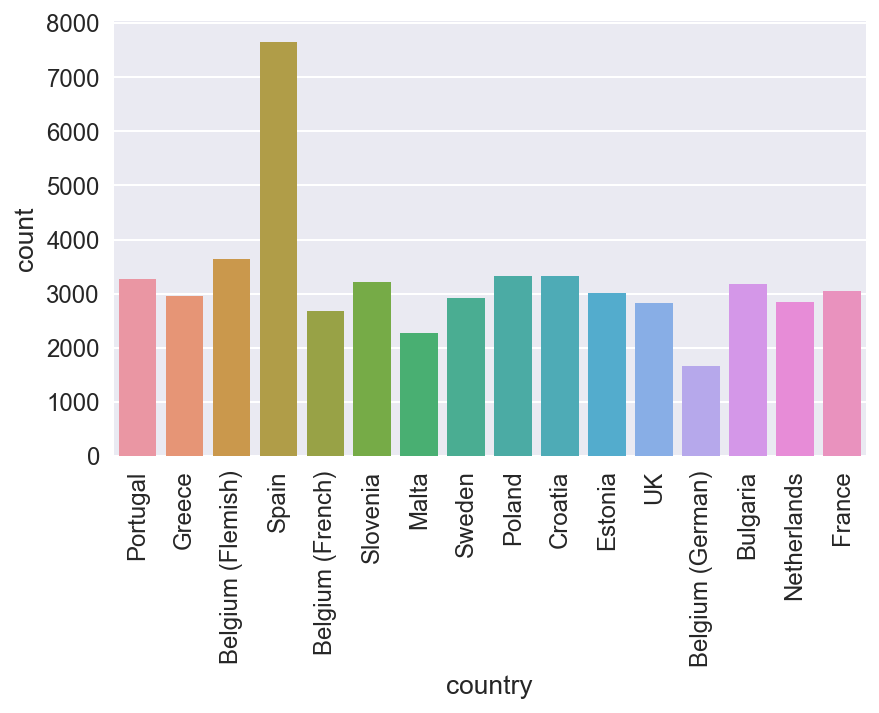

In [160]:
# evaluate ratios of responses per country
sns.countplot(x='country', data=lang, )
plt.xticks(rotation=90);

#### Action
I want to include the overall result levels within this chart to show the distribution in each country.

ie. Groupby, stacked

## Export data to .csv

In [300]:
# set path to save csv
path='/Users/lizspiking/GeneralAssembly/DSI5-lessons/projects/project-capstone/'

# save df to csv
lang.to_csv(path + 'lang_0506.csv', sep=',', na_rep='', float_format=None,\
                 header=True, index=False, mode='w', encoding='UTF-8',\
                 compression=None, quoting=None, quotechar='"',\
                 line_terminator='\n', decimal='.')